# MIDTERM

## VERI YUKLEME

Bu dersin arasınavında , [ChestX-ray8 dataset](https://arxiv.org/abs/1705.02315) veri seti'nden alınan göğüs röntgeni görüntüleriyle çalışacaksınız.
<img src="https://raw.githubusercontent.com/hardik0/AI-for-Medicine-Specialization/master/AI-for-Medical-Diagnosis/Week-1/xray-image.png" alt="U-net Image" width="300" align="middle"/>



In [ ]:
# Import necessary packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import seaborn as sns
sns.set()

In [ ]:
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/

Cloning into 'AI-for-Medicine-Specialization'...
remote: Enumerating objects: 1601, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1601 (delta 9), reused 2 (delta 0), pack-reused 1573 (from 1)
Receiving objects: 100% (1601/1601), 720.36 MiB | 19.64 MiB/s, done.
Resolving deltas: 100% (30/30), done.
Updating files: 100% (1497/1497), done.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis


In [ ]:
%ls nih/

densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


In [ ]:
# Read csv file containing training datadata
train_df = pd.read_csv("nih/train-small.csv")
# Print first 5 rows
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame')
train_df.head()

There are 1000 rows and 16 columns in this data frame


,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0


Have a look at the various columns in this csv file. The file contains the names of chest x-ray images ("Image" column) and the columns filled with ones and zeros identify which diagnoses were given based on each x-ray image.

### Data types and null values check
Run the next cell to explore the data types present in each column and whether any null values exist in the data.

In [ ]:
# Look at the data type of each column and whether null values are present
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Image               1000 non-null   object
 1   Atelectasis         1000 non-null   int64 
 2   Cardiomegaly        1000 non-null   int64 
 3   Consolidation       1000 non-null   int64 
 4   Edema               1000 non-null   int64 
 5   Effusion            1000 non-null   int64 
 6   Emphysema           1000 non-null   int64 
 7   Fibrosis            1000 non-null   int64 
 8   Hernia              1000 non-null   int64 
 9   Infiltration        1000 non-null   int64 
 10  Mass                1000 non-null   int64 
 11  Nodule              1000 non-null   int64 
 12  PatientId           1000 non-null   int64 
 13  Pleural_Thickening  1000 non-null   int64 
 14  Pneumonia           1000 non-null   int64 
 15  Pneumothorax        1000 non-null   int64 
dtypes: int64(15), object(1)
m

### Unique IDs check
"PatientId" has an identification number for each patient. One thing you'd like to know about a medical dataset like this is if you're looking at repeated data for certain patients or whether each image represents a different person.

In [ ]:
print(f"The total patient ids are {train_df['PatientId'].count()}, from those the unique ids are {train_df['PatientId'].value_counts().shape[0]} ")

The total patient ids are 1000, from those the unique ids are 928 


As you can see, the number of unique patients in the dataset is less than the total number so there must be some overlap. For patients with multiple records, you'll want to make sure they do not show up in both training and test sets in order to avoid data leakage (covered later in this week's lectures).

### Explore data labels
Run the next two code cells to create a list of the names of each patient condition or disease.

In [ ]:
columns = train_df.keys()
columns = list(columns)
print(columns)

['Image', 'Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'PatientId', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [ ]:
# Remove unnecesary elements
columns.remove('Image')
columns.remove('PatientId')
# Get the total classes
print(f"There are {len(columns)} columns of labels for these conditions: {columns}")

There are 14 columns of labels for these conditions: ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


Run the next cell to print out the number of positive labels (1's) for each condition

In [ ]:
# Print out the number of positive labels for each class
for column in columns:
    print(f"The class {column} has {train_df[column].sum()} samples")

The class Atelectasis has 106 samples
The class Cardiomegaly has 20 samples
The class Consolidation has 33 samples
The class Edema has 16 samples
The class Effusion has 128 samples
The class Emphysema has 13 samples
The class Fibrosis has 14 samples
The class Hernia has 2 samples
The class Infiltration has 175 samples
The class Mass has 45 samples
The class Nodule has 54 samples
The class Pleural_Thickening has 21 samples
The class Pneumonia has 10 samples
The class Pneumothorax has 38 samples


Have a look at the counts for the labels in each class above. Does this look like a balanced dataset?

### Data Visualization
Using the image names listed in the csv file, you can retrieve the image associated with each row of data in your dataframe.

Run the cell below to visualize a random selection of images from the dataset.

Display Random Images


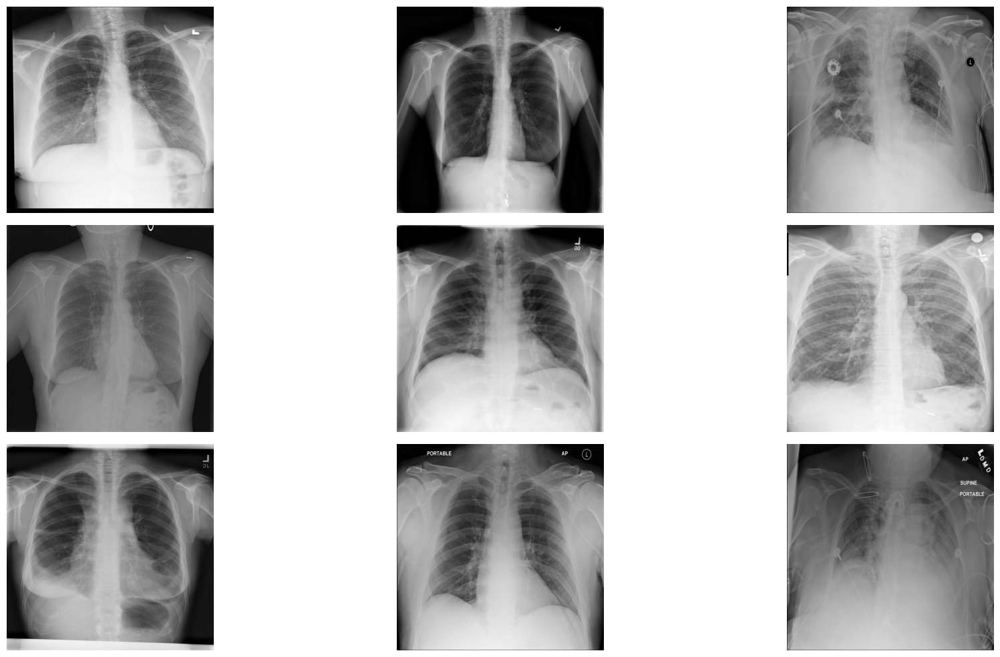

In [ ]:
# Extract numpy values from Image column in data frame
images = train_df['Image'].values

# Extract 9 random images from it
# Sabit random sonuçlar için seed değeri
np.random.seed(99)

# 9 rastgele görsel seçimi
random_images = [np.random.choice(images) for i in range(9)]
#random_images = [np.random.choice(images) for i in range(9)]

# Location of the image dir
img_dir = 'nih/images_small/'

print('Display Random Images')

# Adjust the size of your images
plt.figure(figsize=(20,10))

# Iterate and plot random images
for i in range(9):
    plt.subplot(3, 3, i + 1)
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

# Adjust subplot parameters to give specified padding
plt.tight_layout()

** RASTGELE SECİLMİŞ 9 GÖRÜNTÜNÜN ISTATISTIKSEL ÖZELLİKLERİNİ (MAKSIMUM, MINIMUM, MEAN VE STD) HESAPLAYIN. ORNEK OLARAK BIR GORUNTU ICIN HESAPLAMA YAPILMISTIR

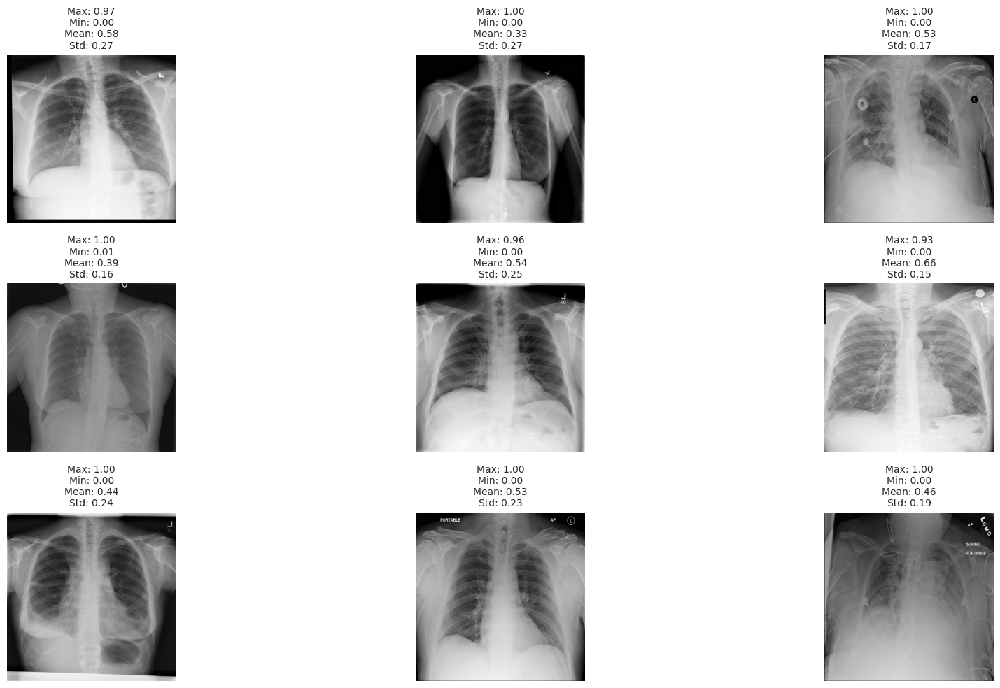

In [ ]:

plt.figure(figsize=(20, 10))

# Her bir görüntü için maksimum, minimum, ortalama ve standart sapma değerlerini hesaplayın ve gösterin
for i in range(9):
    plt.subplot(3, 3, i + 1)

    # Görüntüyü yükleyin ve gösterin
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

    # Görüntü için istatistikleri hesaplayın
    img_max = img.max()
    img_min = img.min()
    img_mean = img.mean()
    img_std = img.std()

    # Alt kısımda hesaplanan değerleri gösterin
    plt.title(f'Max: {img_max:.2f}\nMin: {img_min:.2f}\nMean: {img_mean:.2f}\nStd: {img_std:.2f}', fontsize=10)

plt.tight_layout()
plt.show()

* Maksimum (Max):

Görsellerde maksimum değer genellikle 1.00 olarak verilmiş. Bu, görüntüde tam parlaklığa (örneğin beyaz piksel) ulaşan en az bir piksel olduğunu gösteriyor.
* Minimum (Min):

Minimum değer genellikle 0.00 veya 0.01 olarak görünüyor. Bu, görüntüde tamamen siyah (örneğin, 0 parlaklık) bir pikselin mevcut olduğunu veya çok düşük parlaklıkta bir piksel bulunduğunu ifade ediyor.
* Ortalama (Mean):

Ortalama değerler, her görüntünün genel parlaklık seviyesini yansıtıyor. Örneğin:
Ortalama değerlerin 0.33 ile 0.66 arasında değiştiğini görüyoruz.
Daha düşük bir ortalama (örneğin 0.33), görüntünün genel olarak daha karanlık olduğunu ifade eder. Daha yüksek bir ortalama (örneğin 0.66), görüntünün daha parlak olduğunu gösterir.
* Standart Sapma (Std):

Standart sapma, piksel parlaklıklarının görüntü içinde ne kadar dağıldığını gösterir.
Düşük bir standart sapma (örneğin 0.15), görüntünün homojen olduğunu, yani parlaklıkların daha az çeşitlilik gösterdiğini ifade eder.
Yüksek bir standart sapma (örneğin 0.27), görüntüde parlaklık değerlerinin daha fazla değişiklik gösterdiğini ve kontrastın daha yüksek olduğunu ifade eder.
* Genel Değerlendirme:

Görsellerin istatistiksel değerleri, farklı parlaklık ve kontrast seviyelerine sahip olduklarını gösteriyor. Örneğin, daha yüksek "Mean" ve daha düşük "Std" değerleri homojen ve parlak görüntüleri temsil ederken; düşük "Mean" ve yüksek "Std" değerleri daha karanlık ve kontrastlı görüntüleri temsil ediyor.
Görsellerin tümünde, hem maksimum hem de minimum parlaklık değerleri (1.00 ve 0.00) mevcut olduğundan, her birinde tam siyah ve tam beyaz bölgeler bulunuyor.

RASTGELE SECILMIS 9 GORUNTUNUN HISTOGRAMINI CIZDIRIN. ORNEK OLARAK BIR GORUNTU ICIN VERILMISTIR.

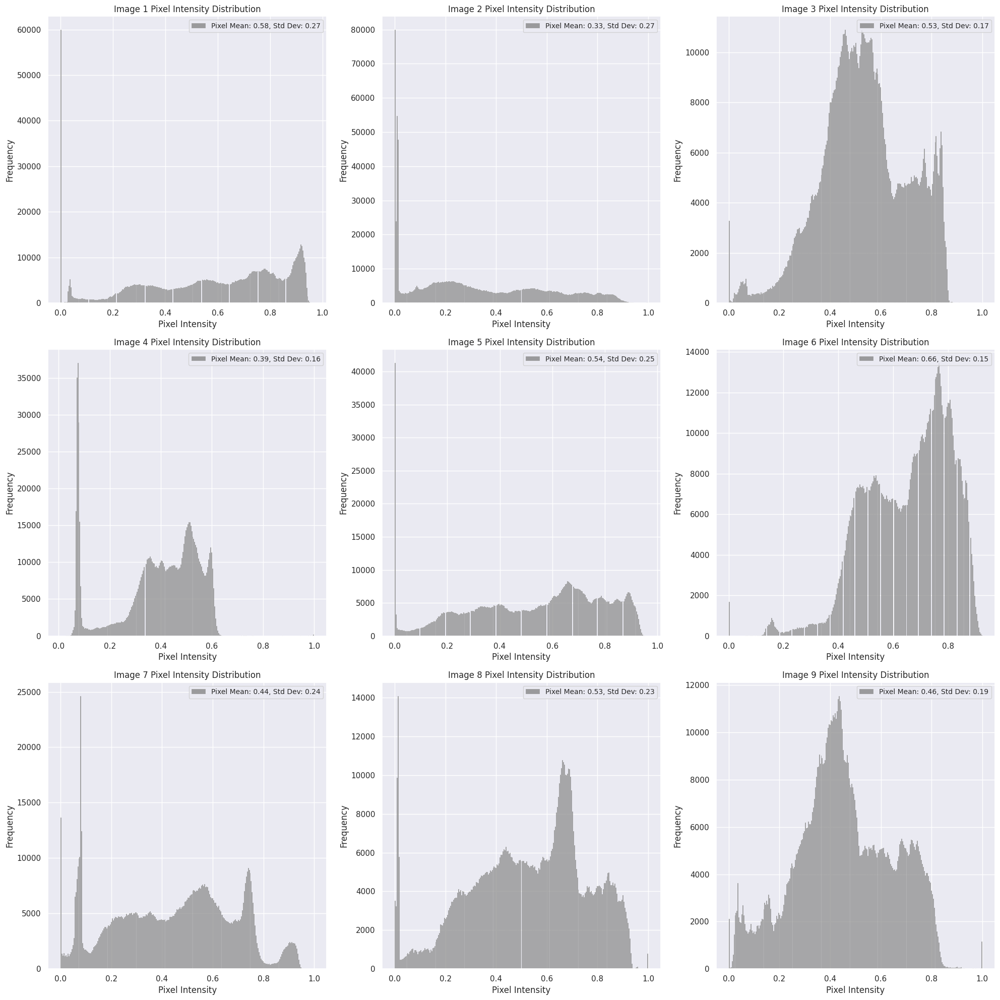

In [ ]:
plt.figure(figsize=(20, 20))

# 9 resim için histogram oluşturma
for i in range(9):
    img_path = os.path.join(img_dir, random_images[i])
    raw_image = plt.imread(img_path)

    plt.subplot(3, 3, i + 1)
    sns.histplot(raw_image.ravel(), bins=256, color='gray', kde=False,
                 label=f'Pixel Mean: {np.mean(raw_image):.2f}, Std Dev: {np.std(raw_image):.2f}')

    plt.legend(loc='upper right', fontsize=10)
    plt.title(f'Image {i+1} Pixel Intensity Distribution')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

* Histogramlar, 0 (tam siyah) ile 1 (tam beyaz) arasındaki piksel yoğunluklarının frekanslarını göstermektedir. Histogramın sol tarafında yoğunluk varsa, görüntüde karanlık bölgelerin fazla olduğunu gösterir. Histogramın sağ tarafında yoğunluk varsa, görüntüde parlak alanların fazla olduğunu ifade eder. Histogramın ortasında birikim varsa, gri tonların (orta parlaklık) yoğunlukta olduğu bir görüntü söz konusudur.

* Image 1:

Piksel yoğunluğu genel olarak 0.4-0.8 arasında yoğunlaşmış. Bu, orta parlaklıkta bir görüntü olduğunu gösteriyor. 0.58 ile ortalama parlak bir görüntüye sahip.  0.27 ile piksel değerlerinde makul bir çeşitlilik var.
* Image 2:

Düşük piksel yoğunlukları (0.0-0.2) yüksek frekansta. Görüntü genel olarak karanlık. 0.33, görüntünün genel olarak karanlık olduğunu teyit ediyor. 0.27 ile kontrast orta düzeyde.
* Image 3:

Piksel yoğunlukları 0.5-0.9 arasında sıklaşmış, bu da daha parlak bir görüntü olduğunu gösteriyor. 0.53, görüntünün nispeten parlak olduğunu destekliyor. 0.17, piksellerin homojen bir dağılıma sahip olduğunu ifade ediyor.
* Image 4:

Histogram iki tepe noktasına sahip (bimodal), bir kısmı karanlık, diğer kısmı orta parlaklıkta yoğunlaşmış. 0.39, görüntünün hafif karanlık olduğunu ifade ediyor. 0.16 ile nispeten düşük kontrastlı bir görüntü.
* Image 5:

Piksel yoğunlukları orta aralıkta (0.3-0.7) yoğunlaşmış, dengeli bir parlaklık söz konusu. 0.54, dengeli bir parlaklığa sahip olduğunu destekliyor. 0.25 ile makul bir çeşitlilik var.
* Image 6:

Histogramın büyük kısmı sağ tarafa kaymış, yani görüntü parlak. 0.66, oldukça parlak bir görüntüyü ifade ediyor. 0.15, piksel değerlerinin oldukça homojen olduğunu gösteriyor.
* Image 7:

Düşük piksel yoğunluklarından yüksek yoğunluklara kadar geniş bir dağılım var, bu da yüksek kontrastlı bir görüntüye işaret ediyor. 0.44, genel parlaklığın dengeli olduğunu gösteriyor. 0.24, çeşitlilik olduğunu gösteriyor.
* Image 8:

Piksel yoğunlukları 0.3-0.7 arasında yoğunlaşmış. Orta parlaklık hâkim. 0.53, dengeli bir parlaklıkta görüntüyü destekliyor. 0.23, orta düzeyde kontrasta işaret ediyor.
* Image 9:

Piksel yoğunluğu 0.3-0.7 arasında yoğunlaşmış, orta parlaklık hâkim. 0.44, hafif karanlık bir görüntü. 0.19 ile kontrast makul düzeyde.



GORUNTULERE CONTRAST STRECTCHING YAPINIZ, CONTRAST STRECTCHING GORUNTULERINE GAMMA TRANSFORMATIONU UYGULAYINIZ. ORNEK OLARAK BIR GORUNTU ICIN VERILMISTIR

In [ ]:
pip install numpy

# Gamma 1,1.5 ve 2.2

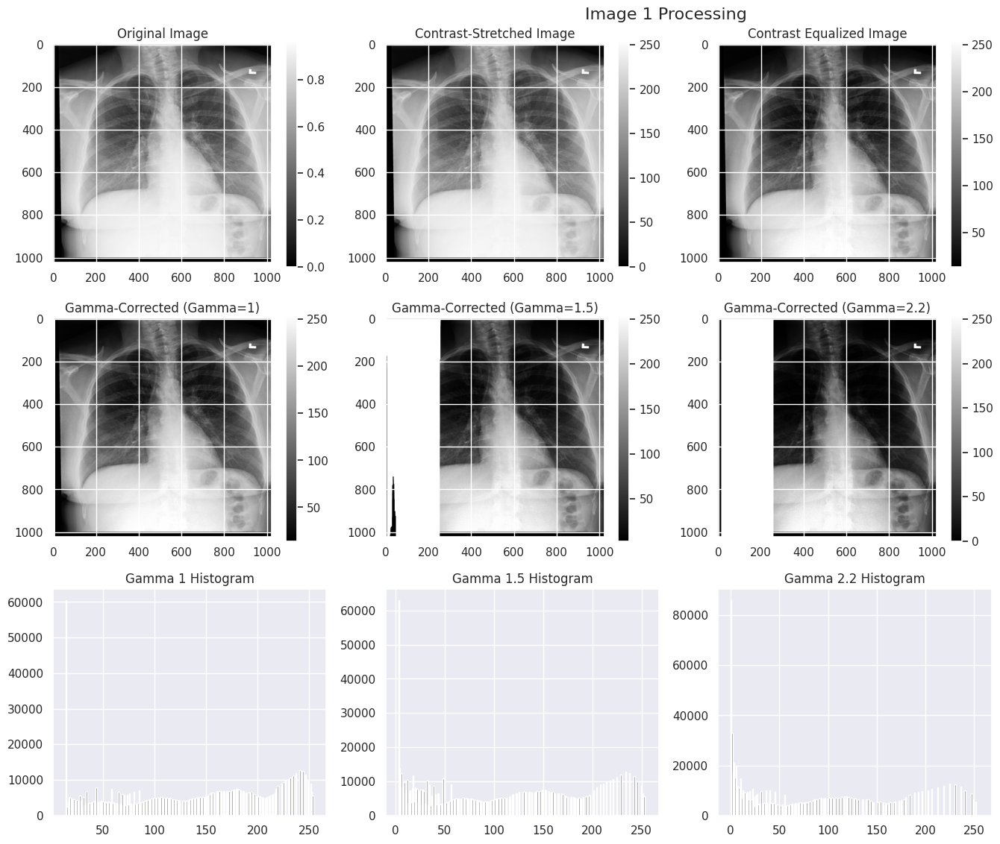

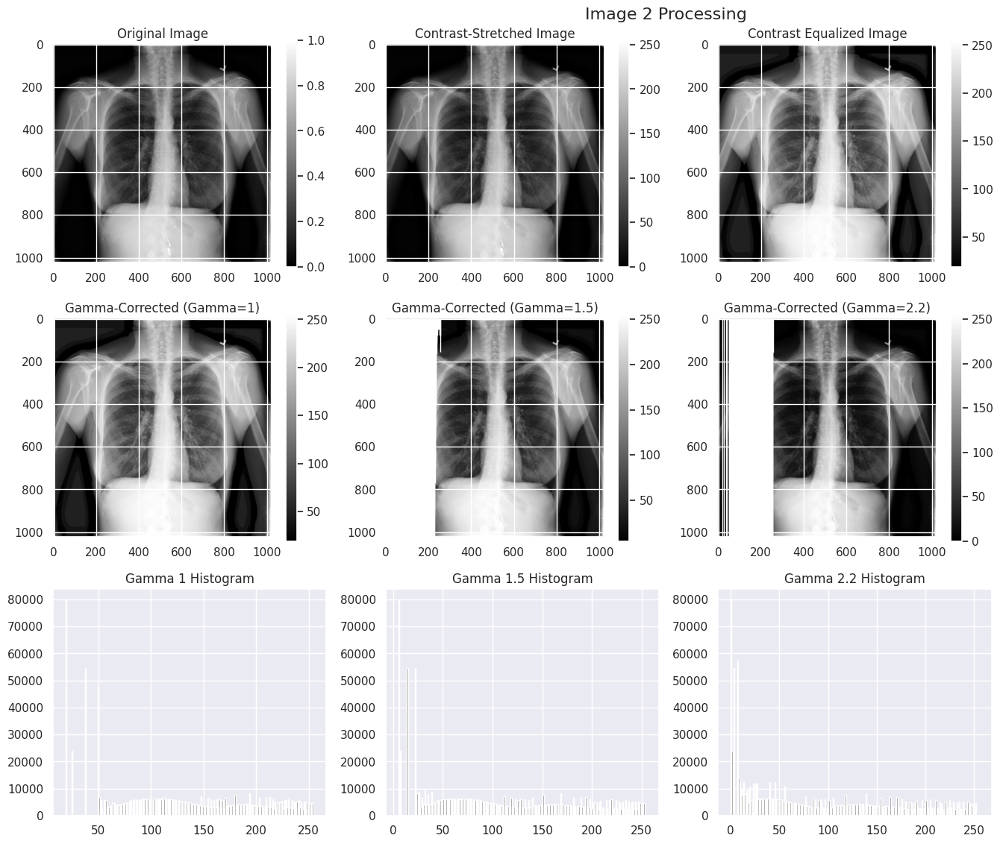

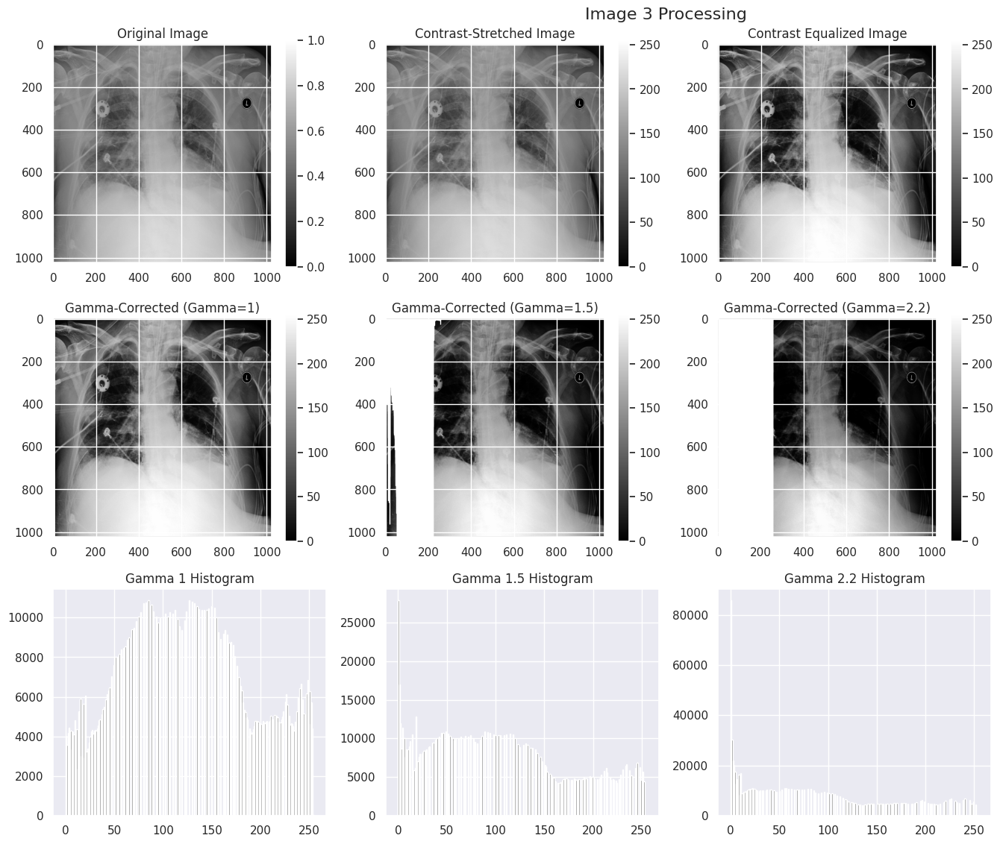

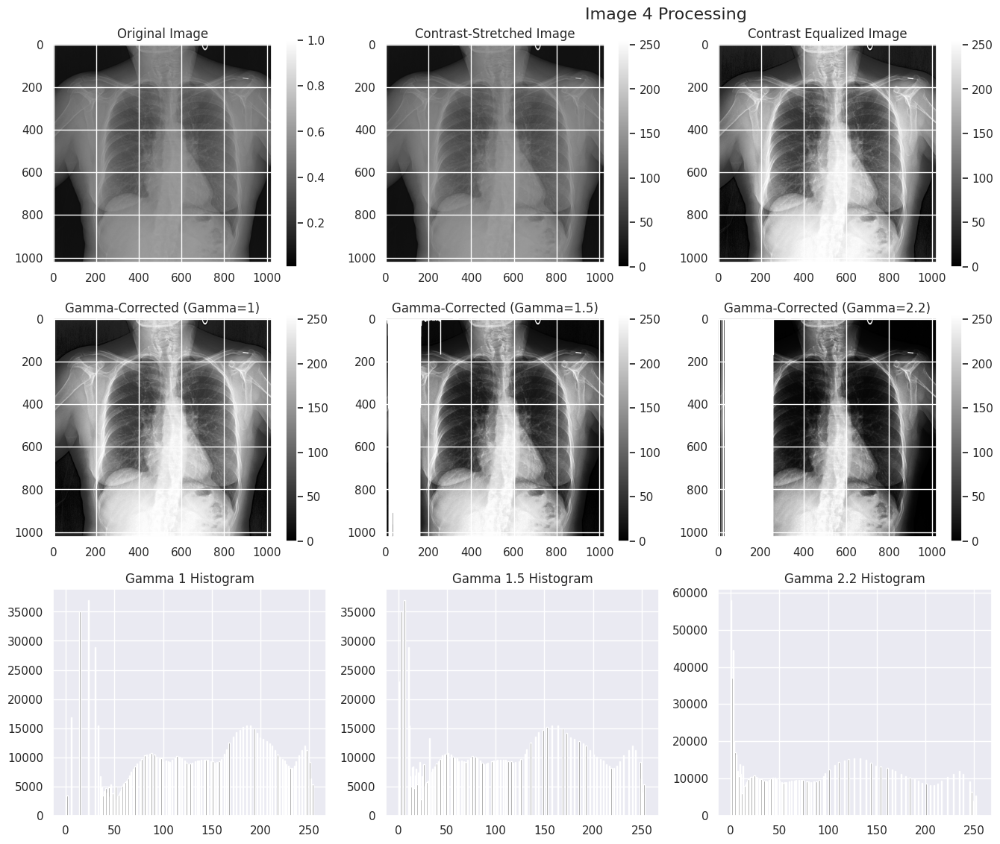

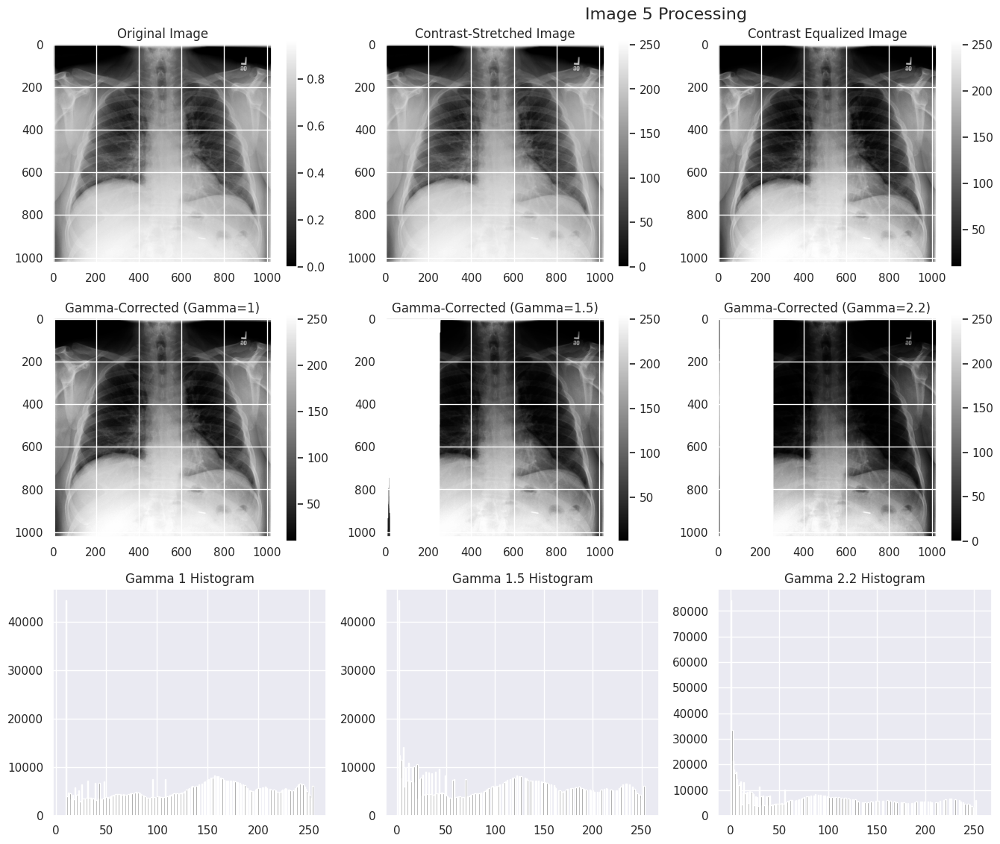

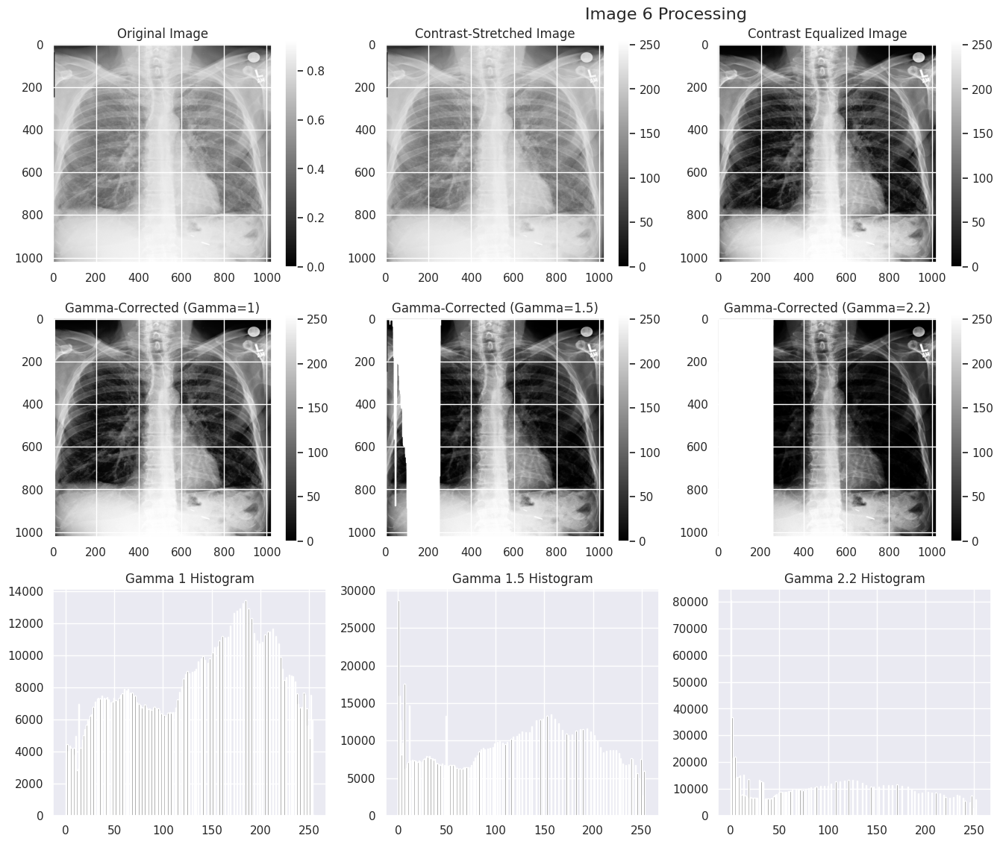

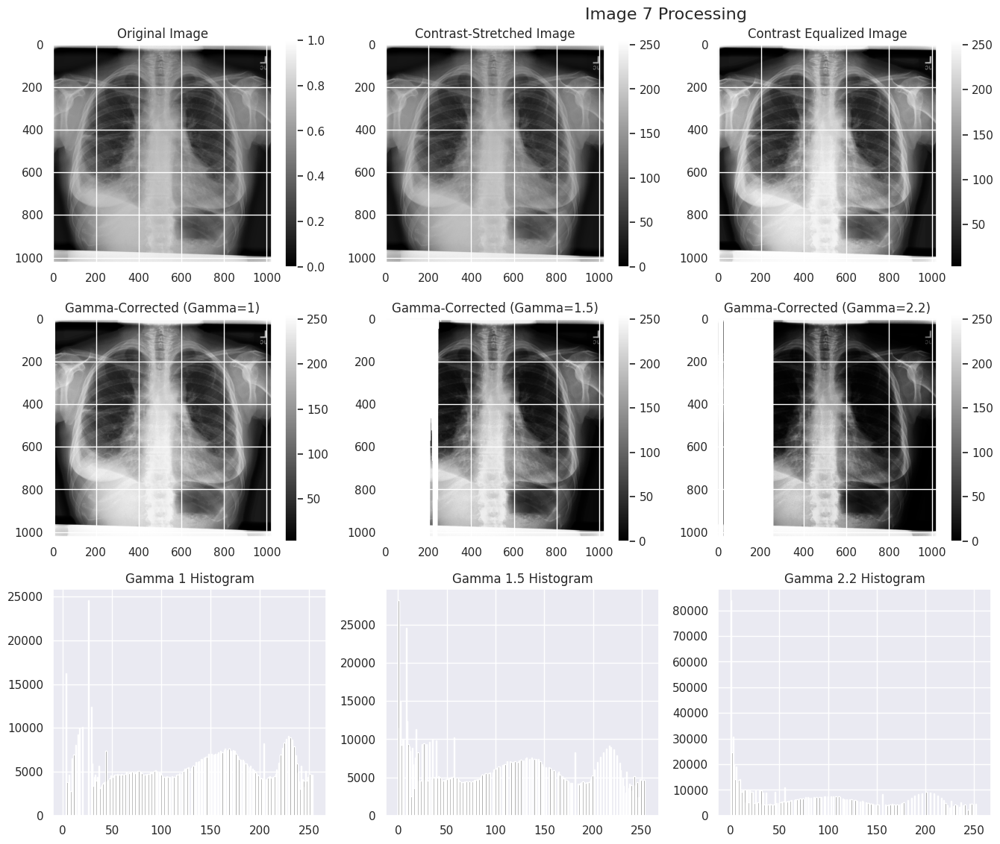

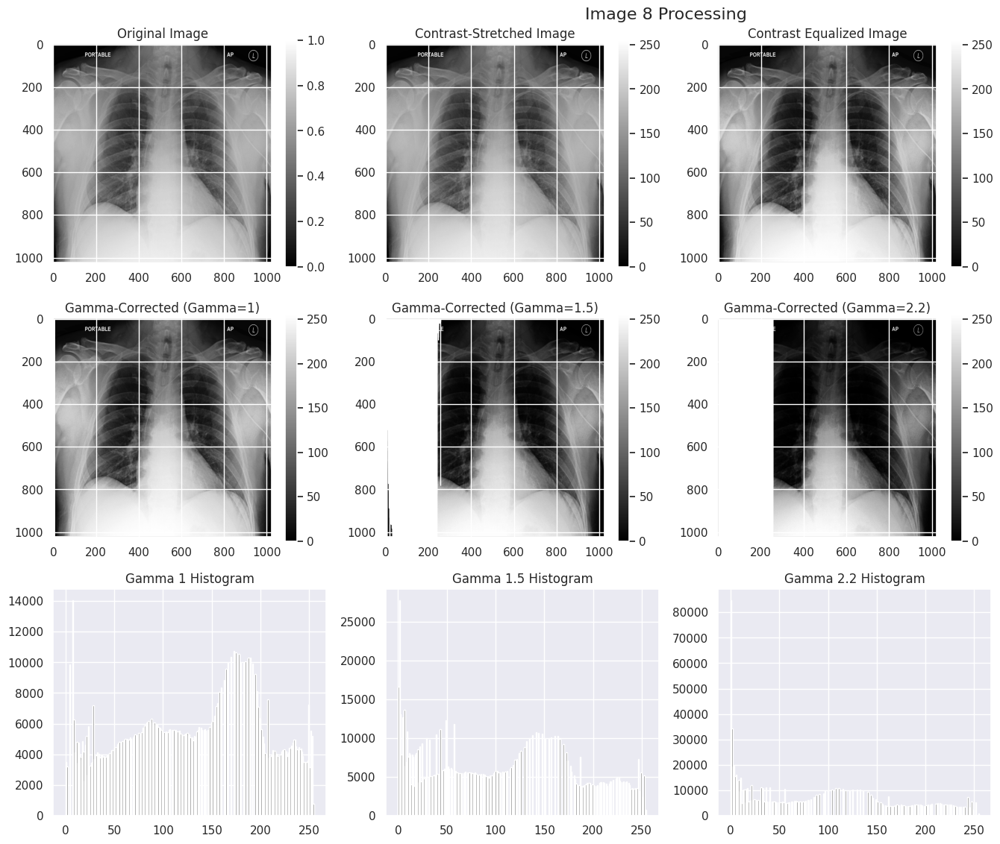

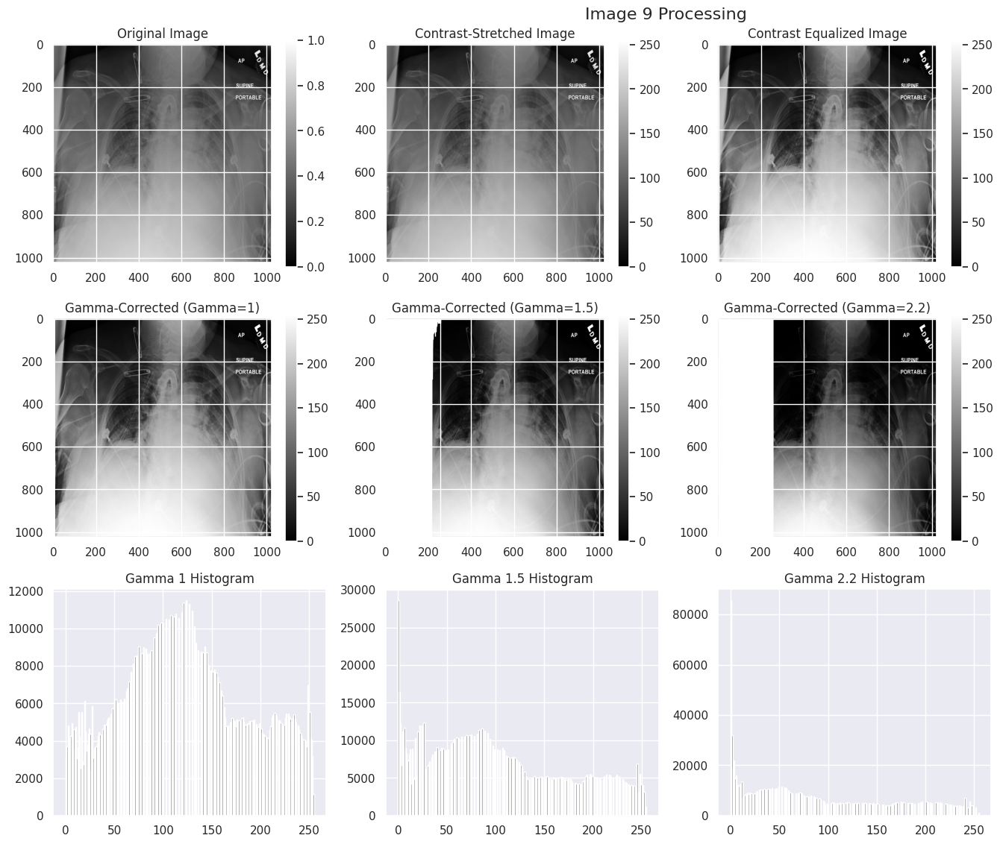

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure
import os  # Import the os module

# Örnek olarak random_images isimli 9 görüntü olduğunu varsayıyoruz
# random_images listesi içerisindeki her bir raw_image üzerinde işlem yapılacak
img_dir = 'nih/images_small/'

# Gamma değerleri listesi
gamma_values = [1, 1.5, 2.2]

for i, image_file in enumerate(random_images, start=1):
    # Her görüntü için min ve max değeri hesapla
    raw_image = plt.imread(os.path.join(img_dir, image_file))
    min_val, max_val = raw_image.min(), raw_image.max()

    # Adım 1: Kontrast genişletme (normalize edip [0, 255] aralığına çekiyoruz)
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # [0, 255] aralığına ölçeklendir

    # Adım 2: Kontrast eşitleme (histogram eşitleme)
    equalized_image = exposure.equalize_hist(contrast_stretched)  # [0, 1] aralığında değer döndürür
    equalized_image = (equalized_image * 255).astype(np.uint8)  # [0, 255] aralığına ölçeklendir

    # Görüntüleri ve histogramları çizdirme
    plt.figure(figsize=(18, 15))
    plt.suptitle(f"Image {i} Processing", fontsize=16)

    # Orijinal görüntü ve histogram
    plt.subplot(4, 4, 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title('Original Image')
    plt.colorbar()
    plt.subplot(4, 4, 5)
    plt.hist(raw_image.ravel(), bins=256, color='gray')
    plt.title("Original Image Histogram")

    # Kontrast genişletilmiş görüntü ve histogram
    plt.subplot(4, 4, 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title('Contrast-Stretched Image')
    plt.colorbar()
    plt.subplot(4, 4, 6)
    plt.hist(contrast_stretched.ravel(), bins=256, color='gray')
    plt.title("Contrast-Stretched Histogram")

    # Histogram eşitlenmiş görüntü ve histogram
    plt.subplot(4, 4, 3)
    plt.imshow(equalized_image, cmap='gray')
    plt.title('Contrast Equalized Image')
    plt.colorbar()
    plt.subplot(4, 4, 7)
    plt.hist(equalized_image.ravel(), bins=256, color='gray')
    plt.title("Equalized Histogram")

    # Her bir gamma değeri için düzeltmeler
    for j, gamma in enumerate(gamma_values):
        gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
        gamma_corrected = gamma_corrected.astype(np.uint8)

        plt.subplot(4, 4, 4 + j + 1)
        plt.imshow(gamma_corrected, cmap='gray')
        plt.title(f'Gamma-Corrected (Gamma={gamma})')
        plt.colorbar()
        plt.subplot(4, 4, 8 + j + 1)
        plt.hist(gamma_corrected.ravel(), bins=256, color='gray')
        plt.title(f"Gamma {gamma} Histogram")

    plt.tight_layout()
    plt.show()


* **Gamma = 1:** Görüntüde herhangi bir gamma düzeltmesi uygulanmamış, histogram orijinal görüntüye çok benzer. Piksel değerleri mevcut yoğunlukta korunmuş.
* **Gamma > 1 (1.5 ve 2.2):** Daha koyu piksel değerlerini daha parlak hale getirerek genel olarak görüntüyü daha parlak yapar. Histogramın sağ tarafa kaymasıyla gözlemlenir.
* **Gamma < 1 :** Görüntü daha koyulaşır, çünkü daha parlak pikseller daha az parlak hale gelir.

**1. Image 1 Processing**
Bu görüntü, temiz ve dengeli bir akciğer röntgeni gibi görünüyor.

* Gamma 1.5: Orijinal görüntüye göre detaylar hafifçe vurgulanmış ve iyi bir denge sağlanmış. Gölgeler belirginleşmiş.
* Gamma 2.2: Görüntü çok karanlık hale gelmiş ve detaylar kaybolmuş. Bu değer fazla agresif.
* Contrast-Stretched: Orijinal görüntüye göre daha net ve keskin görünüyor, kontrast artışı olumlu sonuç vermiş.
* Contrast-Equalized: Parlak ve karanlık bölgeler dengelenmiş, daha dengeli bir görüntü ortaya çıkmış.
* **Sonuç:** Gamma 1.5 ve Contrast-Equalized en iyi sonuçları verirken, Gamma 2.2 önerilmez.

**2. Image 2 Processing**
Bu görüntüde de akciğer röntgeni temiz ve dengeli, ancak daha yumuşak tonlar dikkat çekiyor.

* Gamma 1.5: Görüntü yine yeterince net ve detaylar vurgulanmış, dengeli bir sonuç veriyor.
* Gamma 2.2: Çok koyu, önemli detaylar kaybolmuş. Bu değer yine önerilmez.
* Contrast-Stretched: Detaylar daha netleşmiş ve belirginleşmiş.
* Contrast-Equalized: Kontrast dengesi daha iyi, parlaklık ve gölgeler eşitlenmiş.
* **Sonuç:** Contrast-Equalized burada da iyi sonuç verirken, Gamma 1.5 etkili ve Gamma 2.2 yine çok koyu kalmış.

**3. Image 3 Processing**
Bu görüntüde akciğerlerde lezyon veya anormallik olabilir gibi görünüyor, bu nedenle detayların ön plana çıkması kritik.

* Gamma 1.5: Detaylar belirginleşmiş ve gölgeler daha net hale gelmiş, ideal sonuç.
* Gamma 2.2: Yine çok karanlık, bu nedenle detaylar kayboluyor.
* Contrast-Stretched: Görüntü çok net, detaylar ve kontrast güzel vurgulanmış.
* Contrast-Equalized: Dengeli bir parlaklık sağlamış ancak bazı bölgeler gölgelenmiş gibi.
* **Sonuç:** Gamma 1.5 ve Contrast-Stretched bu görüntüde en iyi sonucu verir, zira detaylar netleşiyor. Gamma 2.2 önerilmez.

**4. Image 4 Processing**
Bu görüntüde akciğer yapısı oldukça açık, belirgin detaylara ihtiyaç var.

* Gamma 1.5: Yine ideal denge sağlanmış, detaylar net.
* Gamma 2.2: Görüntü fazla koyu olmuş ve kontrast çok fazla kaybolmuş.
* Contrast-Stretched: Detaylar çok daha net ve görünür durumda, gayet başarılı.
* Contrast-Equalized: Daha dengeli parlaklık ve detay vurgusu sağlanmış.
* **Sonuç:** Contrast-Stretched ve Gamma 1.5 iyi sonuçlar verirken, Gamma 2.2 kullanımı burada da uygun değil.

**5. Image 5 Processing**
* Gamma 1.5: Orta seviyede iyileştirme ve iyi bir denge.
* Gamma 2.2: Aşırı karanlık, kontrast kaybolmuş.
* Contrast-Stretched: Gözle görülür iyileşme, detaylar açıkça belirgin.
* Contrast-Equalized: Dengeli detay görünümü.
* **Sonuç:** Contrast-Stretched bu görüntüde de en iyi sonucu verirken, Gamma 1.5 alternatif olarak düşünülebilir.

**6. Image 6 Processing**
* Gamma 1.5: Görüntüde dengeli bir iyileşme sağlanmış.
* Gamma 2.2: Aşırı karanlık, görüntü tanınmaz hale geliyor.
* Contrast-Stretched: Keskin detaylarla oldukça başarılı.
* Contrast-Equalized: Parlaklık ve kontrast dengesi iyi.
* **Sonuç:** Contrast-Stretched en iyi performansı sergilerken, Gamma 1.5 makul bir alternatif sunuyor.

**7. Image 7 Processing**
Gamma 1.5: Detaylar yeterince iyi görünüyor.
Gamma 2.2: Aşırı koyu ve kontrast eksikliği.
Contrast-Stretched: En iyi sonuç, detaylar belirgin.
Contrast-Equalized: Dengeli ve hoş bir görünüm.
Sonuç: Yine Contrast-Stretched ve Gamma 1.5 etkili iken, Gamma 2.2 uygun değil.

**9. Image 9 Processing**
* Gamma 1.5: İdeal denge sağlanmış, detaylar net.
* Gamma 2.2: Görüntü fazla koyu olmuş, kontrast kaybı belirgin.
* Contrast-Stretched: Detaylar daha net ve görünür, başarılı bir iyileştirme.
* Contrast-Equalized: Parlaklık ve detay vurgusu dengeli.
* **Sonuç:** Contrast-Stretched ve Gamma 1.5 burada iyi sonuçlar sunuyor. Gamma 2.2 uygun değil.

**8. Image 8 Processing**

* Gamma 1.5: İdeal bir denge sağlanmış, detaylar belirgin ve parlaklık oldukça iyi.

* Gamma 2.2: Görüntü fazla koyu olmuş, detay kaybı ve kontrast eksikliği dikkat çekiyor.

* Contrast-Stretched: Detaylar daha net hale getirilmiş, aydınlık ve karanlık alanlar dengelenmiş. Oldukça başarılı bir iyileştirme.

* Contrast-Equalized: Parlaklık daha dengeli ve detaylar iyi vurgulanmış, bazı bölgelerde gürültü artışı olabilir.

* **Sonuç:** Contrast-Stretched ve Gamma 1.5, görüntü iyileştirme açısından en etkili yöntemlerdir. Gamma 2.2, aşırı koyulaşma nedeniyle uygun bir seçenek değildir.



#Gamma Corrected

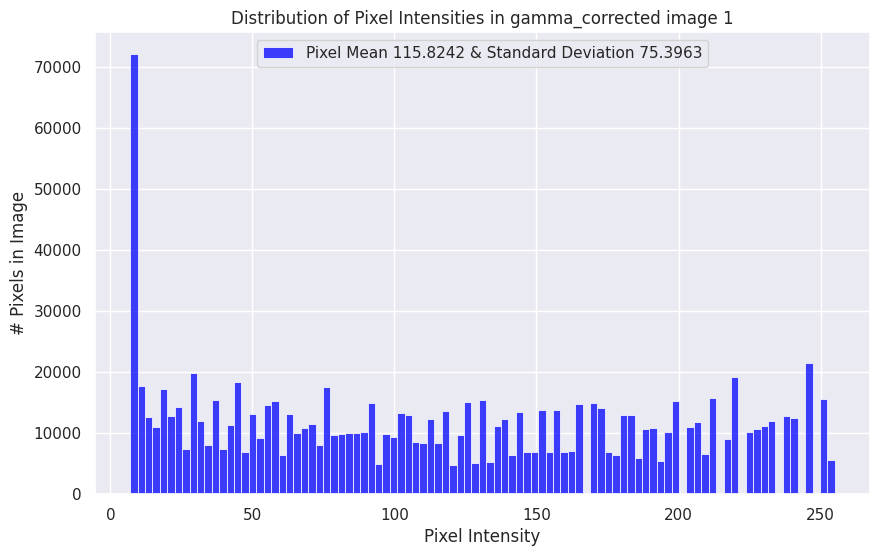

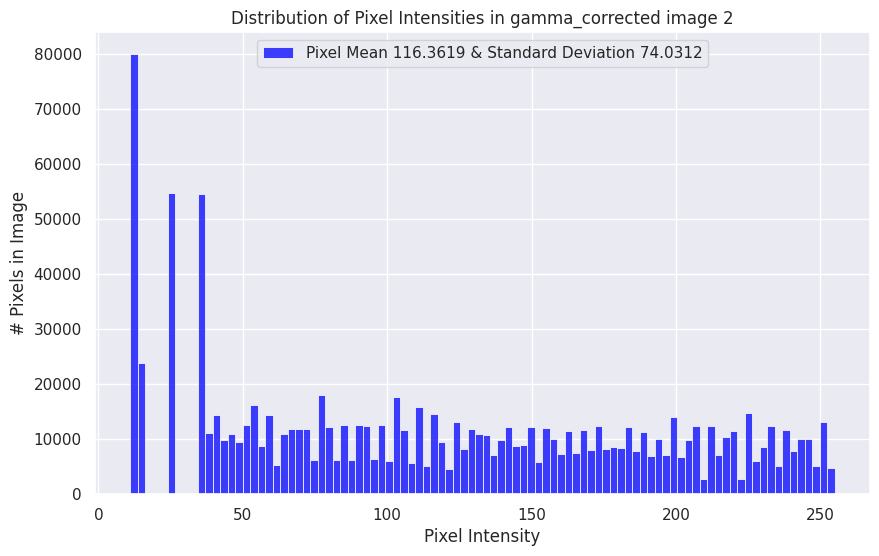

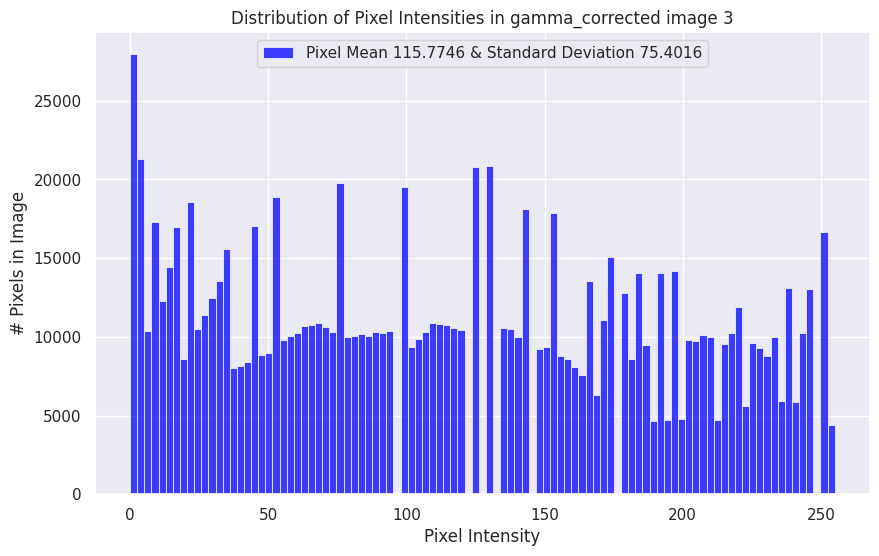

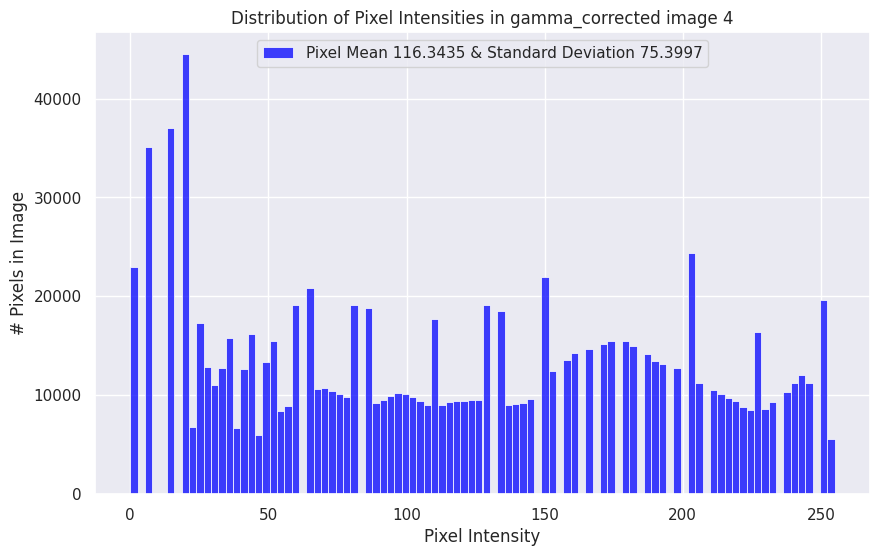

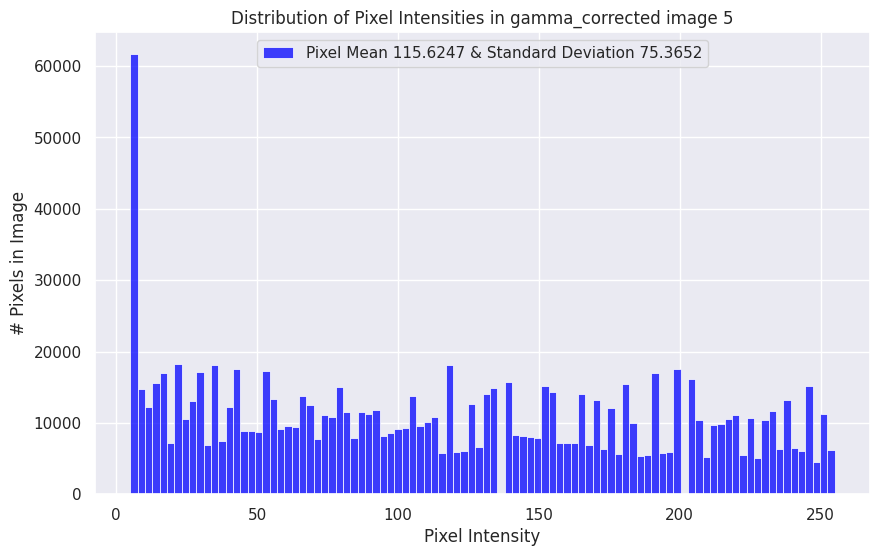

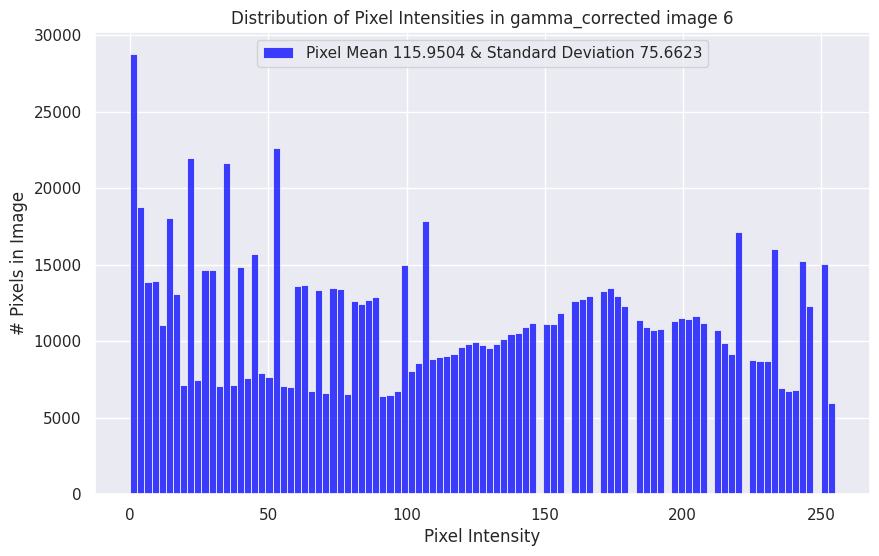

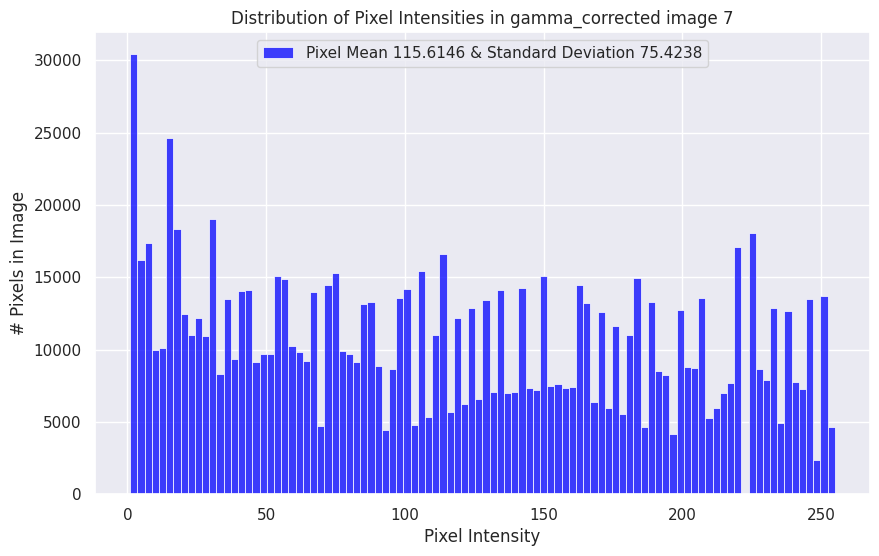

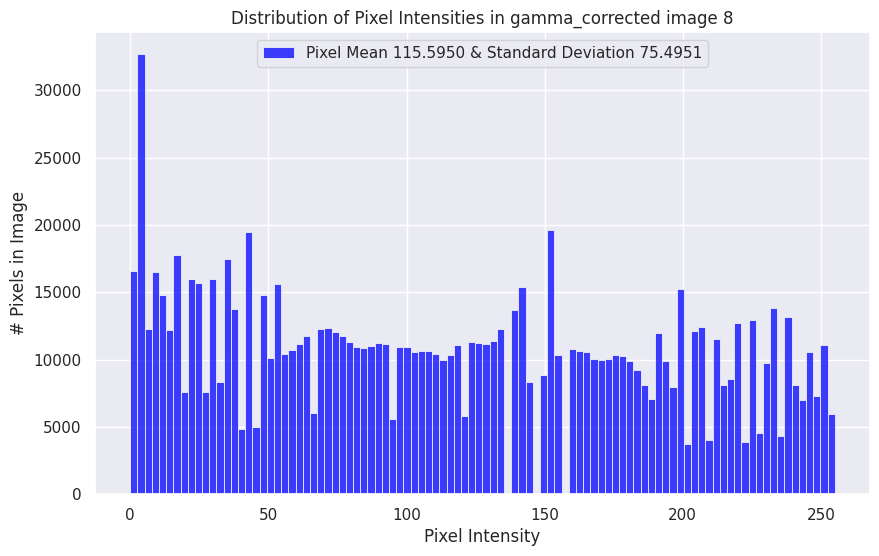

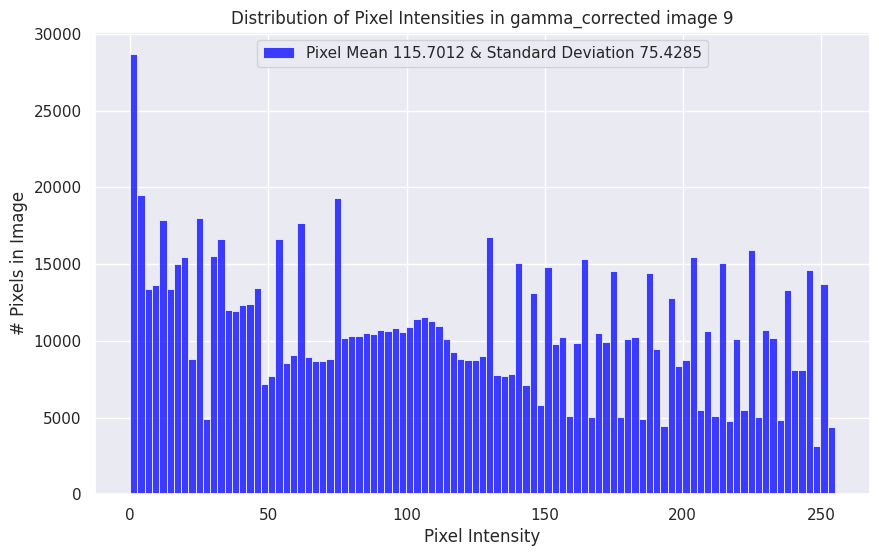

In [ ]:
def process_images_and_plot_histograms(images, img_dir):
    for i, image_name in enumerate(random_images, start=1):
        # Görüntüyü yükle
        image_path = os.path.join(img_dir, image_name)
        raw_image = plt.imread(image_path)

        # Her görüntü için min ve max değeri hesapla
        min_val, max_val = raw_image.min(), raw_image.max()

        # Adım 1: Kontrast genişletme (normalize edip [0, 255] aralığına çekiyoruz)
        contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize [0, 1]
        contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # [0, 255] aralığına ölçeklendir

        # Adım 2: Kontrast eşitleme (histogram eşitleme)
        equalized_image = exposure.equalize_hist(contrast_stretched)  # [0, 1] aralığında değer döndürür
        equalized_image = (equalized_image * 255).astype(np.uint8)  # [0, 255] aralığına ölçeklendir

        # Adım 3: Gamma düzeltmesi
        gamma = 1.2  # Gamma değeri
        gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
        gamma_corrected = gamma_corrected.astype(np.uint8)

        # Görüntü histogramını çizdirme
        plt.figure(figsize=(10, 6))
        sns.histplot(gamma_corrected.ravel(),
                     label=f'Pixel Mean {np.mean(gamma_corrected):.4f} & Standard Deviation {np.std(gamma_corrected):.4f}', kde=False, color='blue')
        plt.legend(loc='upper center')
        plt.title(f'Distribution of Pixel Intensities in gamma_corrected image {i}')
        plt.xlabel('Pixel Intensity')
        plt.ylabel('# Pixels in Image')
        plt.show()

# Fonksiyonu çağır ve her görüntü için histogramları çizdir
process_images_and_plot_histograms(random_images, img_dir)

1. Grafik
* Pixel Mean: 115.6146
* Standard Deviation: 75.4238
* Bu grafik, piksel yoğunluklarının oldukça geniş bir alana yayıldığını gösteriyor. Piksel yoğunluğu dağılımı nispeten dengeli görünüyor, ancak yoğunluk değerleri 50 ile 200 arasında eşit şekilde dağılmış gibi değil, bazı bölümlerde hafif sıçramalar mevcut.
2. Grafik
* Pixel Mean: 115.5950
* Standard Deviation: 75.4951
* Bu grafik, birinci grafikle oldukça benzer. Ortalama piksel değeri (Pixel Mean) çok yakın ve yoğunluk dağılımı da benzer bir şekilde geniş bir alana yayılmış. Ancak bu grafikte, bazı piksel değerlerinde daha belirgin bir yoğunlaşma var gibi görünüyor.
3. Grafik
* Pixel Mean: 115.7746
* Standard Deviation: 75.4016
* Piksel ortalaması birinci ve ikinci grafiklerden biraz daha yüksek. Yoğunluk dağılımı yine geniş bir aralıkta, ancak piksel yoğunluğu 200’e yaklaştıkça daha belirgin bir yoğunlaşma fark ediliyor.
4. Grafik
* Pixel Mean: 115.8242
* Standard Deviation: 75.3963
* Bu grafikteki yoğunluk dağılımı, önceki grafikleri andırıyor. Piksel ortalaması biraz daha yüksek, ancak standart sapma neredeyse sabit. Bu, yoğunluğun benzer şekilde dağılmaya devam ettiğini gösteriyor.
5. Grafik
* Pixel Mean: 115.9504
* Standard Deviation: 75.6623
* Ortalamadaki hafif artış, görüntünün genel parlaklık seviyesinin biraz yükseldiğini gösterebilir. Yoğunluk dağılımı diğer grafiklere kıyasla 200’e doğru daha sık yoğunlaşmış görünüyor.
6. Grafik
* Pixel Mean: 116.3435
* Standard Deviation: 75.3997
* Ortalama değerin diğer grafiklere göre en yüksek olduğu grafik. Bu durum, genel piksel parlaklığının daha fazla olduğunu işaret ediyor. Yoğunluk dağılımı, özellikle 150’den itibaren daha yoğun ve belirgin hale gelmiş.
7. Grafik
* Pixel Mean: 116.3619
* Standard Deviation: 74.0312
* Bu grafikte standart sapma diğerlerinden biraz daha düşük. Bu durum, yoğunluk dağılımının daha dar bir aralığa sıkıştığını ve genel piksel parlaklığının daha homojen olduğunu gösterebilir.
8. Grafik
* Pixel Mean: 115.7012
* Standard Deviation: 75.4285
* Ortalama değeri tekrar 115 seviyesine gerilemiş. Standart sapma ve dağılım yapısı 1. ve 2. grafiğe oldukça benziyor. Bu grafik, yoğunluklarda çok fazla farklılık olmayan bir yapıya işaret ediyor.
9. Grafik
* Pixel Mean: 115.6247
* Standard Deviation: 75.3652
* Son grafikte ortalama değer yine 115 seviyelerinde. Standart sapma düşük değil, ancak yoğunluk dağılımında 50 ile 150 arasındaki yoğunluklarda daha eşit bir dağılım fark ediliyor.

# MEDIAN VE GAUSSIAN

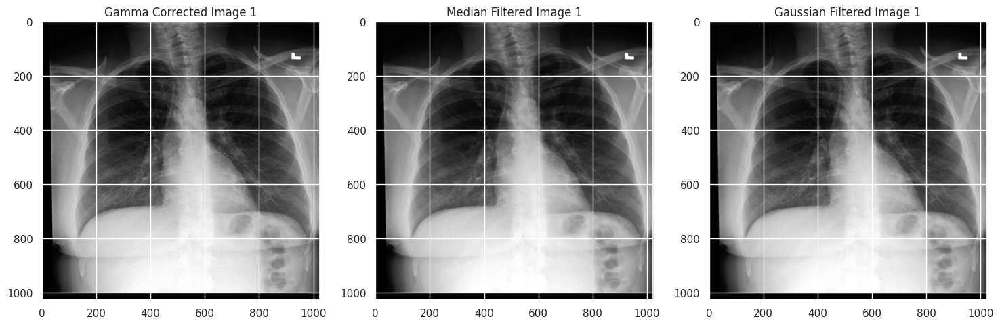

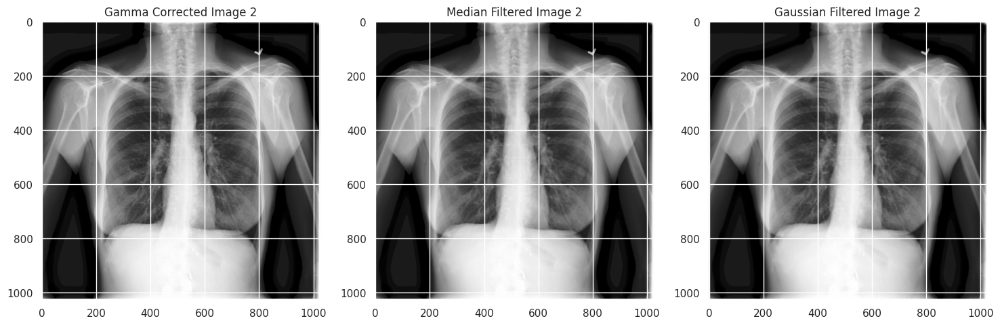

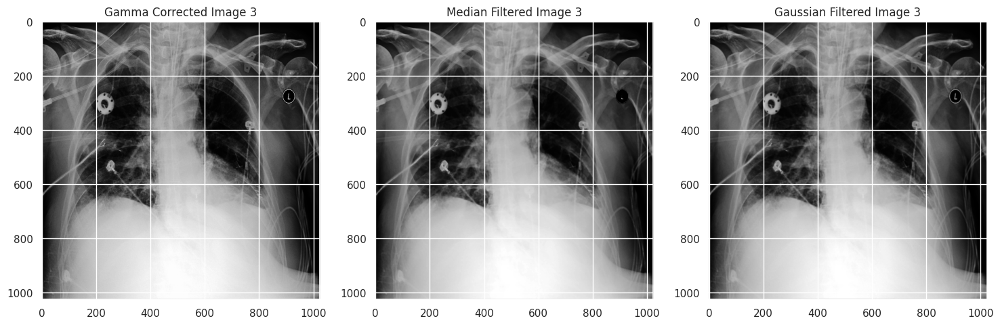

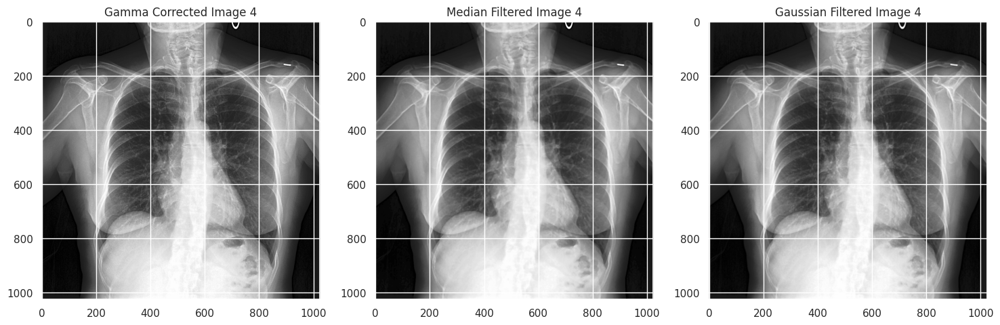

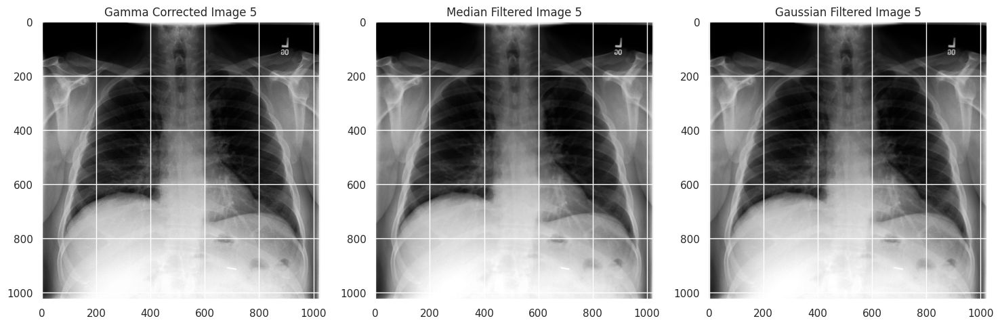

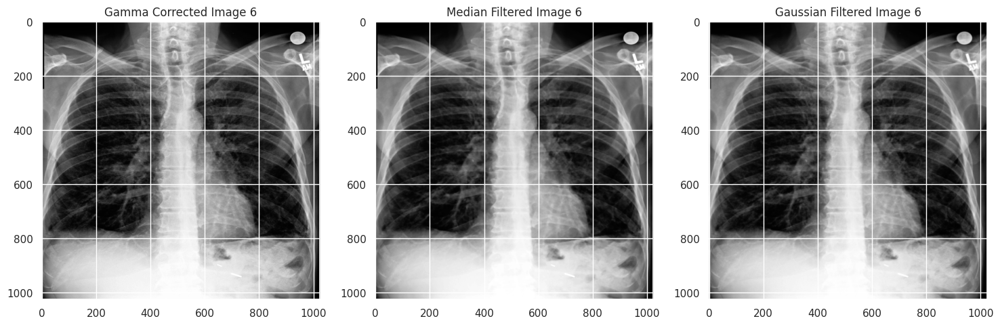

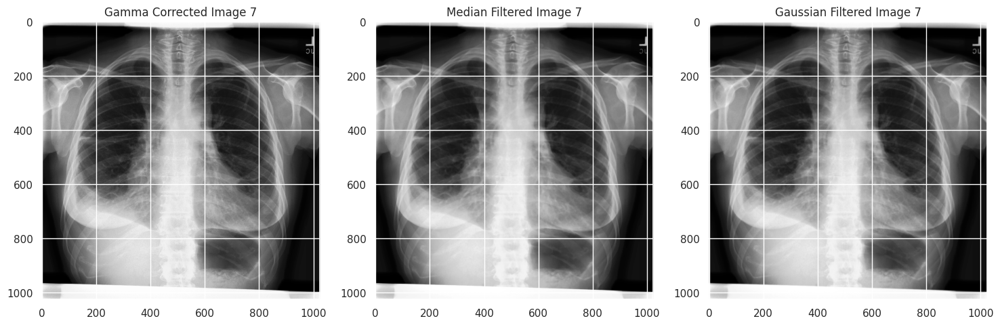

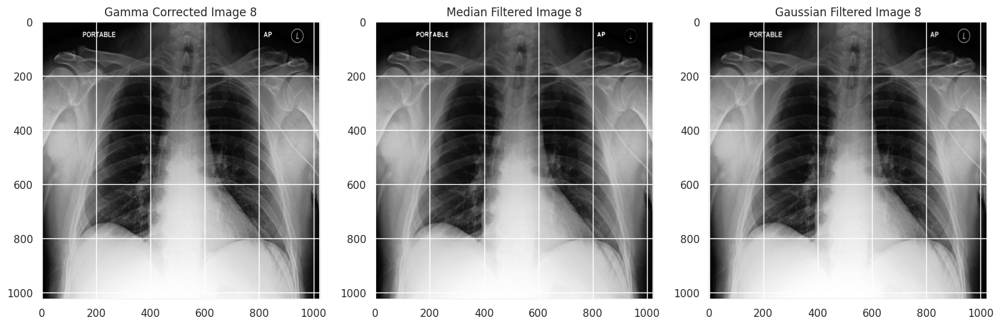

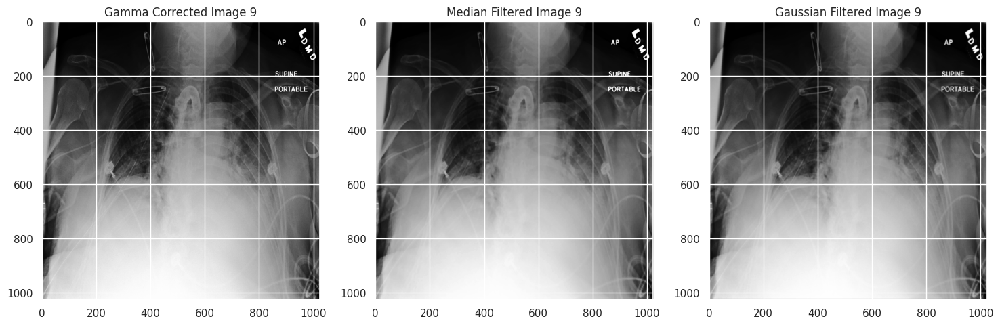

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from skimage import exposure

def process_images_and_display(random_images, img_dir, gamma=1.2):
    for i, image_name in enumerate(random_images, start=1):
        # Görüntüyü yükle
        image_path = os.path.join(img_dir, image_name)
        raw_image = plt.imread(image_path)

        # Kontrast genişletme ve gamma düzeltmesi
        min_val, max_val = raw_image.min(), raw_image.max()
        contrast_stretched = (raw_image - min_val) / (max_val - min_val) * 255
        contrast_stretched = contrast_stretched.astype(np.uint8)

        equalized_image = exposure.equalize_hist(contrast_stretched) * 255
        equalized_image = equalized_image.astype(np.uint8)

        gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
        gamma_corrected = gamma_corrected.astype(np.uint8)

        # Gaussian ve median filtreleri uygula
        median_filtered = cv2.medianBlur(gamma_corrected, 5)
        gaussian_filtered = cv2.GaussianBlur(gamma_corrected, (5, 5), 0)

        # Sonuçları yan yana görüntüle
        plt.figure(figsize=(18, 6))

        # Gamma corrected image
        plt.subplot(1, 3, 1)
        plt.imshow(gamma_corrected, cmap='gray')
        plt.title(f'Gamma Corrected Image {i}')

        # Median filtered image
        plt.subplot(1, 3, 2)
        plt.imshow(median_filtered, cmap='gray')
        plt.title(f'Median Filtered Image {i}')

        # Gaussian filtered image
        plt.subplot(1, 3, 3)
        plt.imshow(gaussian_filtered, cmap='gray')
        plt.title(f'Gaussian Filtered Image {i}')

        plt.show()

# Fonksiyonu çağır ve her görüntü için işlem ve çizimleri yap
process_images_and_display(random_images, img_dir, gamma=1.2)



1. Image 1
* Gamma Düzeltme: Detayları ön plana çıkararak özellikle parlak alanlarda belirginleşme sağlamış.
* Median Filtreleme: Kenarların korunması, filtrelemenin önemli bir avantajı olmuş. Gürültü azalmış, ama detaylar hala algılanabilir düzeyde.
* Gaussian Filtreleme: Daha yumuşak geçişler sağlanmış, fakat kontrast biraz kaybolmuş gibi görünüyor.
2. Image 2
* Gamma Düzeltme: Hafif bir parlaklık artışı gözlemleniyor, bu da detayların netleşmesini sağlıyor.
* Median Filtreleme: Gürültü azaltımı median ile çok etkili olmuş. Kenarlar belirgin ve görüntü dengeli.
* Gaussian Filtreleme: Daha yumuşak bir sonuç sunuyor, ancak detaylar azalmış.
3. Image 3
* Gamma Düzeltme: Görüntü kontrastını artırarak daha fazla detay görünürlüğü sağlamış.
* Median Filtreleme: Kenarların korunması sayesinde görüntü netliği yüksek.
* Gaussian Filtreleme: Gürültü kontrolü sağlanmış ancak bu, daha fazla detay kaybına yol açmış.
4. Image 4
* Gamma Düzeltme: Karanlık alanlar daha net, bu da görüntünün analiz edilmesini kolaylaştırıyor.
* Median Filtreleme: Gürültüden arındırılmış, ancak kenarlar hala iyi korunuyor.
* Gaussian Filtreleme: Gürültüyü giderirken görüntüde yumuşama ve hafif bir detay kaybı yaratmış.
5. Image 5
* Gamma Düzeltme: Kontrast ve parlaklık artışı detayları iyileştiriyor.
* Median Filtreleme: Gürültü azaltımı etkili ve kenar korunumu gayet iyi.
* Gaussian Filtreleme: Yumuşak geçişler mevcut, ama kenar keskinliği kaybolmuş gibi.
6. Image 6
* Gamma Düzeltme: Görüntüdeki ince ayrıntılar, parlaklık artışı ile daha belirgin.
* Median Filtreleme: Görüntü detayları korunmuş, bu filtre netliği bozmadan gürültüyü azaltıyor.
* Gaussian Filtreleme: Detaylar daha az belirgin ama genel olarak düzgün bir görüntü oluşturulmuş.
7. Image 7 (Gamma, Median, Gaussian)
* Gamma Düzeltme: Görüntü, parlaklık ve kontrastı artırarak daha net bir görünüm sağlıyor. Özellikle karanlık bölgeler daha belirgin hale geliyor.
* Median Filtreleme: Kenarları koruyarak gürültü giderimi sağlanmış. Keskin kenarlar hala algılanabilir, ancak bazı ince detaylar kaybolmuş olabilir.
* Gaussian Filtreleme: Genel yumuşama sağlanmış; görüntü daha pürüzsüz hale gelmiş ancak kenarlardaki detay kaybı median filtreye göre daha fazla.
8. Image 8
* Gamma Düzeltme: Görüntüdeki ince ayrıntılar öne çıkarılmış.
* Median Filtreleme: Kenar detaylarını koruyarak dengeli bir netlik sağlıyor.
* Gaussian Filtreleme: Detaylar silikleşmiş, daha yumuşak bir görünüm hakim.
9. Image 9
* Gamma Düzeltme: Görüntüdeki kontrastın artmasıyla karanlık alanlar daha belirgin.
* Median Filtreleme: Gürültü azaltımı ve kenar korunumu dengeli bir sonuç sunuyor.
* Gaussian Filtreleme: Yumuşaklık mevcut, ancak bu detayların kaybolmasına neden olmuş.
# **Genel Sonuç**
* Gamma Düzeltme: Görsellerde kontrast ve parlaklığı artırarak detayların görünürlüğünü iyileştiriyor.
* Median Filtreleme: Gürültüyü azaltmada etkili ve kenar detaylarını koruyor; genelde daha keskin sonuçlar veriyor.
* Gaussian Filtreleme: Görsellerde genel bir yumuşama sağlıyor; detayların kaybına rağmen daha pürüzsüz sonuçlar üretiyor.

DERECESI RASTGELE 0 ILA 10 ARASINDA OLACAK SEKILDE ROTATION UYGULAYIN GORUNTUYE FLIPPING UYGULAYIN

# ROTATION AND FLIPPING

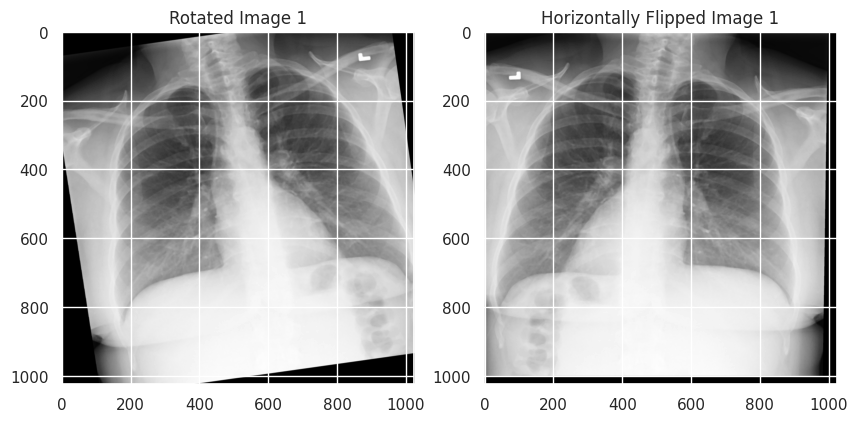

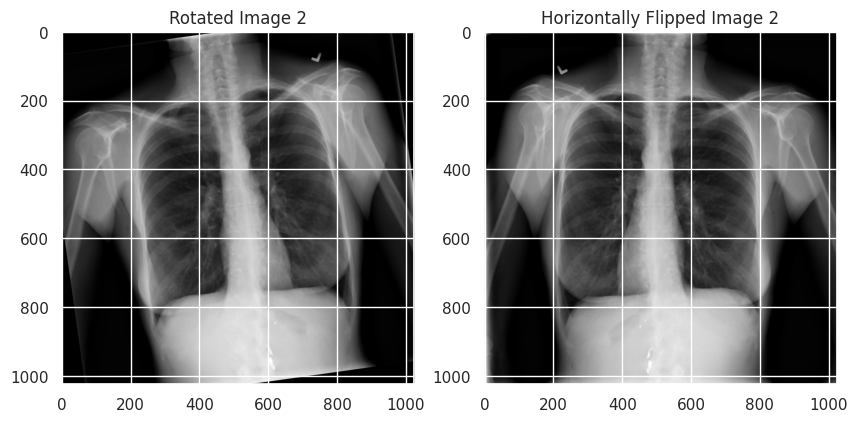

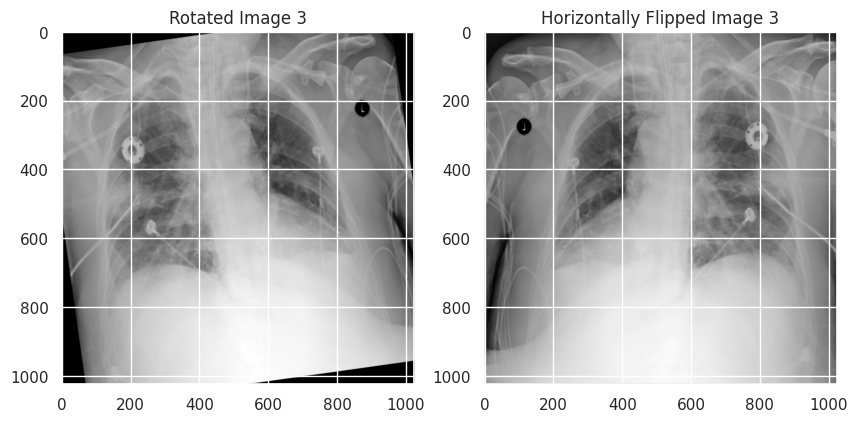

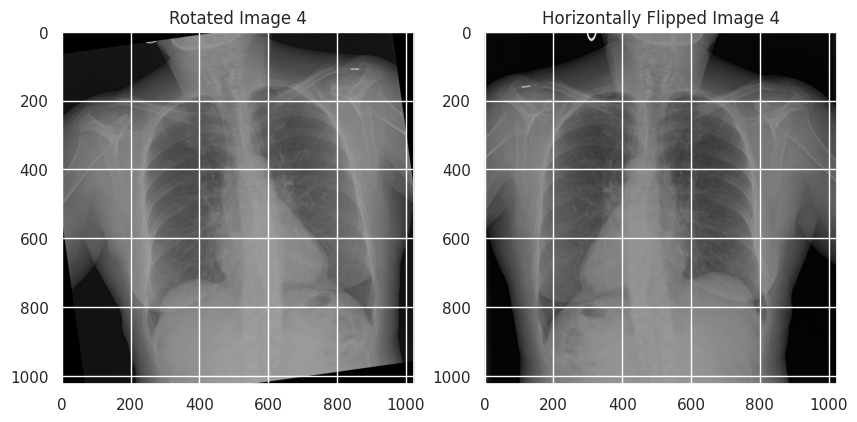

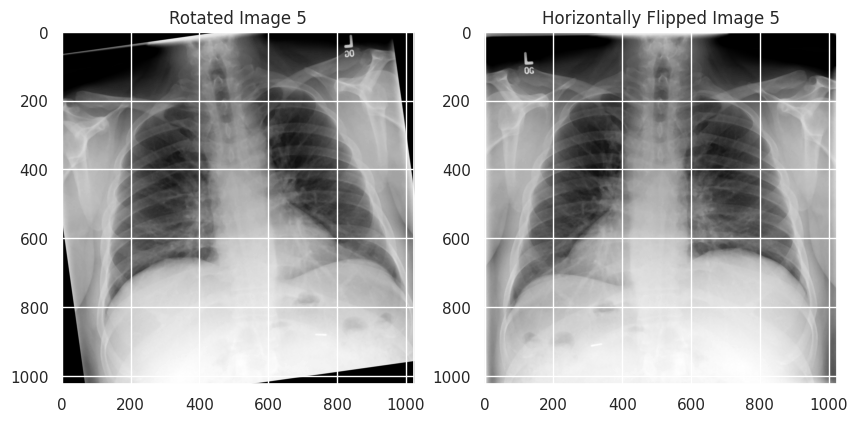

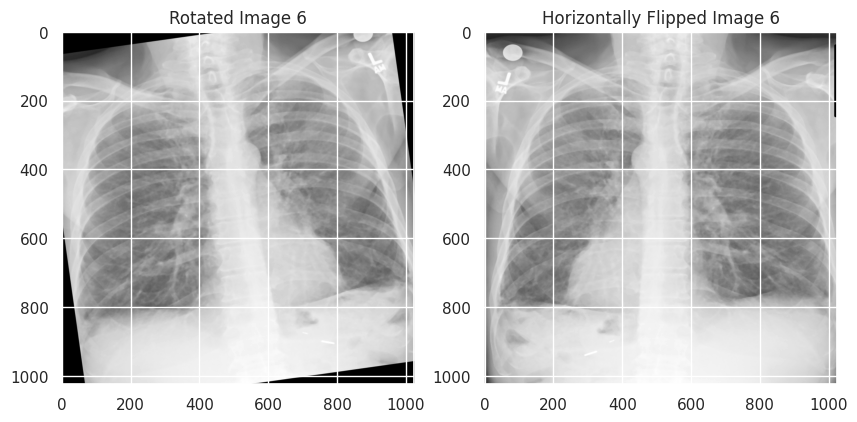

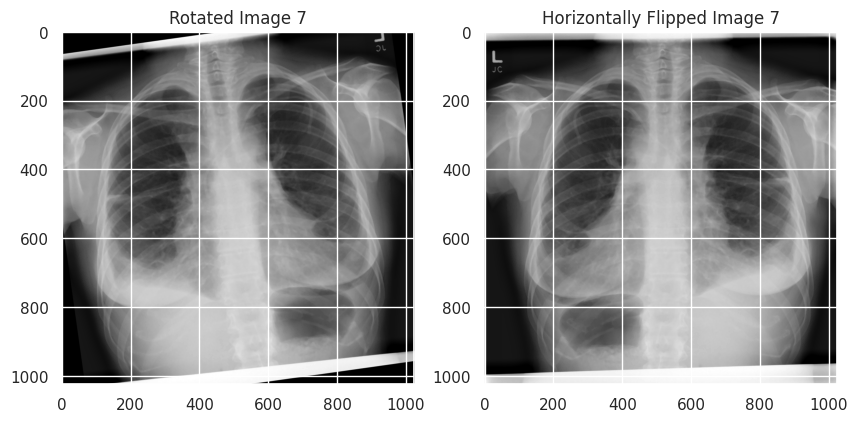

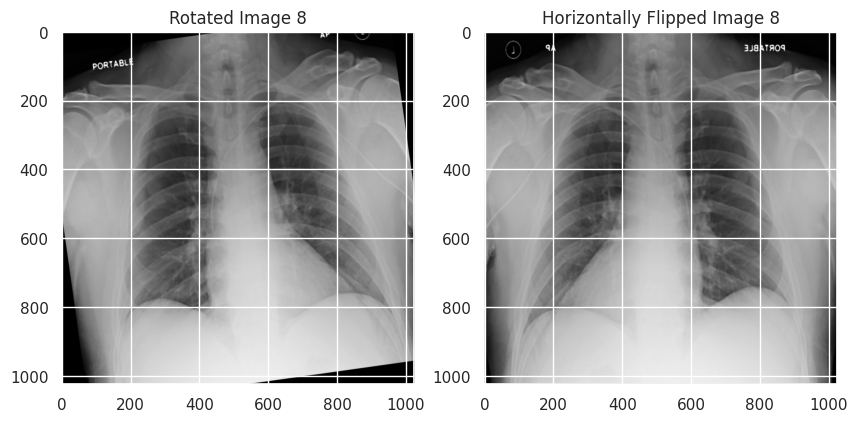

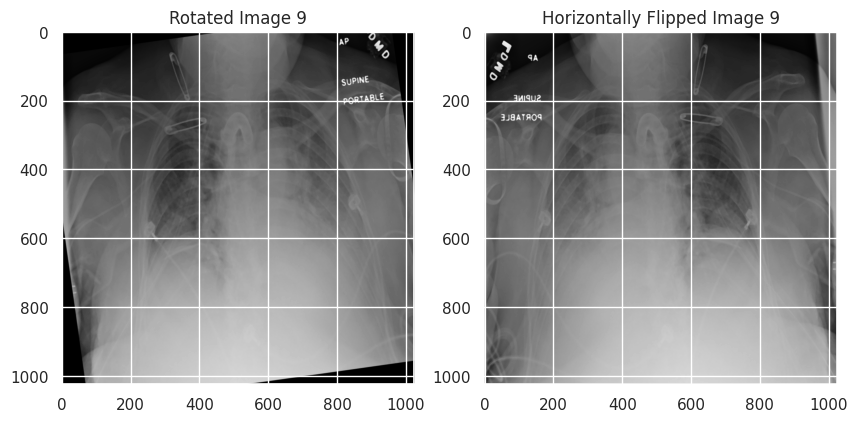

In [ ]:
import cv2
import os
import matplotlib.pyplot as plt

def process_and_display_transformed_images(random_images, img_dir):
    for i, image_file in enumerate(random_images, start=1):
        # Görüntüyü yükle
        image_path = os.path.join(img_dir, image_file)
        raw_image = plt.imread(image_path)

        # Adım 1: Median filtreleme
        median_filtered = cv2.medianBlur((raw_image * 255).astype(np.uint8), 5)

        # Adım 2: 10 derece döndürme
        center = (median_filtered.shape[1] // 2, median_filtered.shape[0] // 2)
        rotation_matrix = cv2.getRotationMatrix2D(center, angle=8, scale=1.0)
        rotated_image = cv2.warpAffine(median_filtered, rotation_matrix, (median_filtered.shape[1], median_filtered.shape[0]))

        # Adım 3: Yatay çevirme
        flipped_horizontal = cv2.flip(median_filtered, 1)

        # Görüntüleri yan yana çizdirme
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1), plt.imshow(rotated_image, cmap='gray'), plt.title(f"Rotated Image {i}")
        plt.subplot(1, 2, 2), plt.imshow(flipped_horizontal, cmap='gray'), plt.title(f"Horizontally Flipped Image {i}")
        plt.show()

# Fonksiyonu çağır ve her görüntü için dönüşümleri uygula
process_and_display_transformed_images(random_images, img_dir)


# Fourier Dönüşümü ve Filtreleme


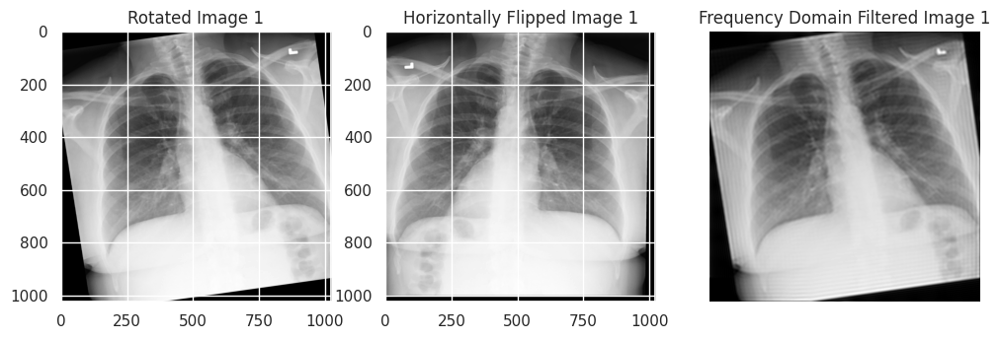

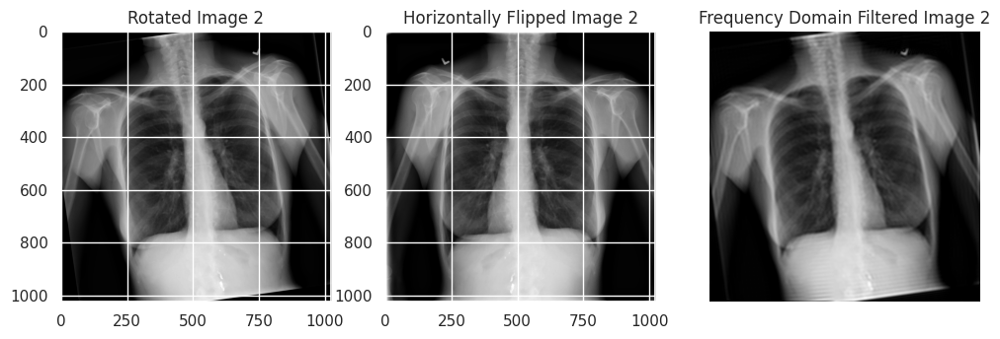

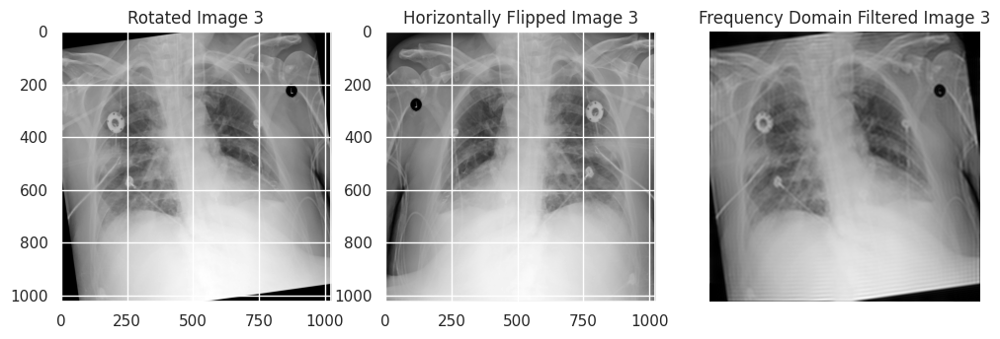

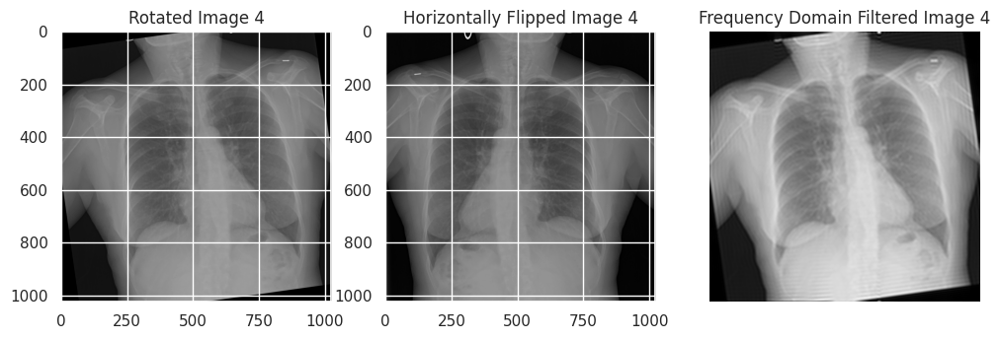

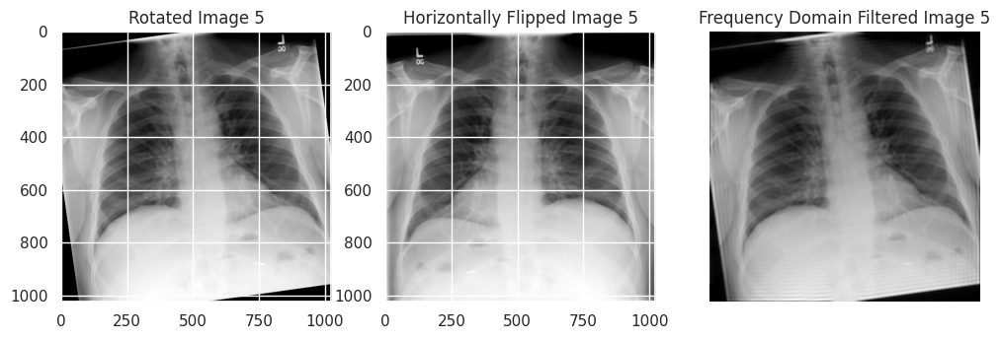

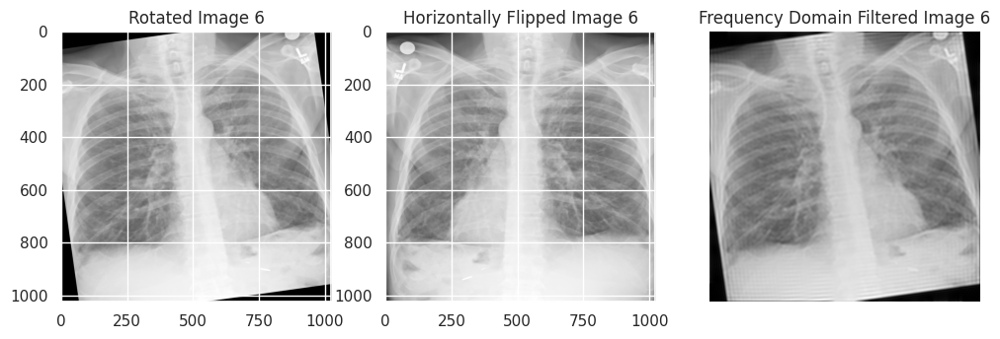

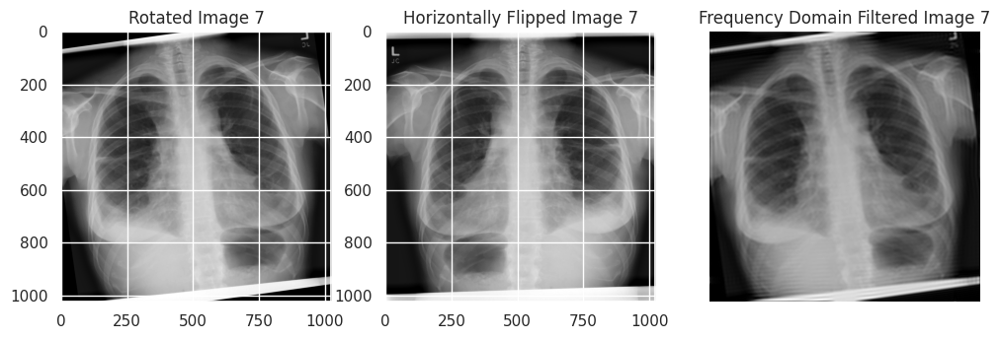

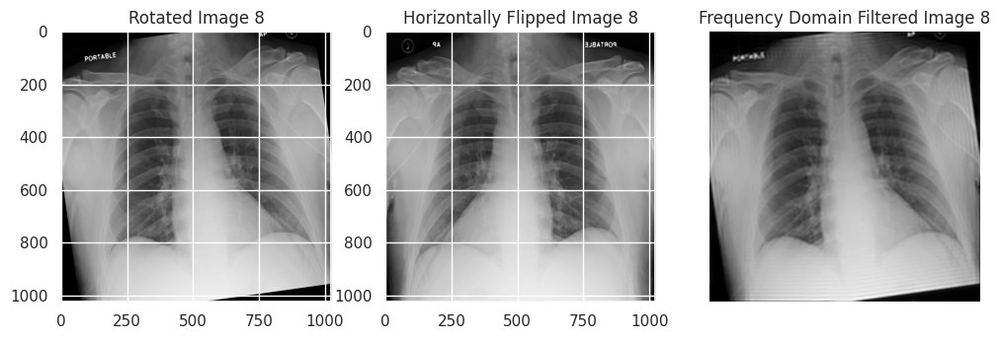

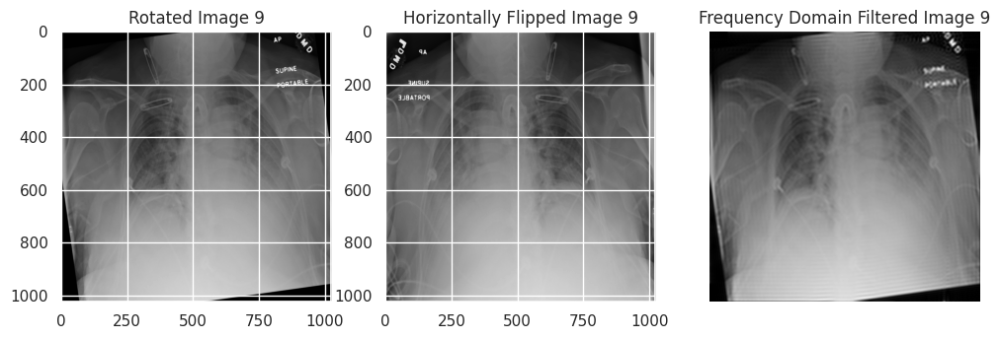

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

def process_images_with_fourier(random_images, img_dir, angle=10, mask_size=30):
    for i, image_file in enumerate(random_images, start=1):
        # Görüntüyü yükle
        image_path = os.path.join(img_dir, image_file)
        raw_image = plt.imread(image_path)

        # Median filtre uygula
        median_filtered = cv2.medianBlur((raw_image * 255).astype(np.uint8), 5)

        # Döndürme işlemi
        center = (median_filtered.shape[1] // 2, median_filtered.shape[0] // 2)
        rotation_matrix = cv2.getRotationMatrix2D(center, angle=angle, scale=1.0)
        rotated_image = cv2.warpAffine(median_filtered, rotation_matrix, (median_filtered.shape[1], median_filtered.shape[0]))

        # Yatay çevirme
        flipped_horizontal = cv2.flip(median_filtered, 1)

        # Fourier Dönüşümü ve Frekans Filtreleme
        dft = cv2.dft(np.float32(rotated_image), flags=cv2.DFT_COMPLEX_OUTPUT)
        dft_shifted = np.fft.fftshift(dft)
        rows, cols = rotated_image.shape
        crow, ccol = rows // 2, cols // 2
        mask = np.zeros((rows, cols, 2), np.uint8)
        mask[crow-mask_size:crow+mask_size, ccol-mask_size:ccol+mask_size] = 1  # Mask boyutunu belirliyor
        fshift = dft_shifted * mask
        f_ishift = np.fft.ifftshift(fshift)
        filtered_image = cv2.idft(f_ishift)
        filtered_image = cv2.magnitude(filtered_image[:, :, 0], filtered_image[:, :, 1])

        # Normalize edilmesi
        filtered_image = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX)
        filtered_image = filtered_image.astype(np.uint8)

        # Görüntüleri yan yana gösterme
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 3, 1), plt.imshow(rotated_image, cmap='gray'), plt.title(f"Rotated Image {i}")
        plt.subplot(1, 3, 2), plt.imshow(flipped_horizontal, cmap='gray'), plt.title(f"Horizontally Flipped Image {i}")
        plt.subplot(1, 3, 3), plt.imshow(filtered_image, cmap='gray'), plt.title(f"Frequency Domain Filtered Image {i}")
        plt.axis("off")
        plt.show()

# Fonksiyonu çağır ve her görüntü için işlemleri uygula
process_images_with_fourier(random_images, img_dir, angle=8, mask_size=66)


1. Image 1
* Rotated
Bu görüntü, belirli bir açıyla döndürülerek yeni bir bakış açısı oluşturmuş. Döndürme işlemi, özellikle görüntüdeki yapısal hatların veya kenarların model tarafından farklı algılanmasına olanak sağlar. Ancak, kenar boşluklarında oluşan siyah alanlar bilgi kaybına neden olabilir. Veriyi artırma amaçlı faydalı olabilir.

* Horizontally Flipped
Görüntünün yatay olarak çevrilmesi, özellikle sağ ve sol akciğerin yapısal simetrilerinin incelenmesine olanak tanır. Görüntüdeki bilgiler aynı kalmasına rağmen, yön değişikliği nedeniyle sinir ağları farklı bir perspektifte öğrenme sağlayabilir.

* Frequency Domain Filtered
Bu görüntüde frekans alanında filtreleme yapılmış. Görüntü detayları hafifçe yumuşatılmış ya da belirginleştirilmiş olabilir. Frekans alanı filtrelemesi, düşük frekanslı bileşenleri koruyarak genel bir yapı sunar ve yüksek frekanslı detayları filtreler. Bu, özellikle ana hatları incelemek isteyen modeller için faydalıdır.
2. Image 2

*Rotated
Döndürme işlemi, bu görüntüde de yeni bir bakış açısı kazandırmıştır. Görüntüdeki yapısal hatlar aynı kalmış, ancak kenar alanlarındaki siyah bölgeler bilgi kaybı yaratabilir.

* Horizontally Flipped
Bu görüntü, 2. resimdeki gibi yatay simetri oluşturmuştur. Görüntünün sağ ve sol tarafları yer değiştirmiştir. Veriyi artırmak ve modelin daha genelleştirilebilir sonuçlar üretmesi için yararlı bir yöntemdir.

* Frequency Domain Filtered
Frekans filtreleme sayesinde görüntü daha pürüzsüz bir hale getirilmiş olabilir. Detayların azalması, modelin genel yapıya odaklanmasını sağlayabilir. Bu işlem, gürültüyü azaltma ve önemli yapısal detayları koruma açısından etkilidir.

3. Image 3
* Rotated
Bu resim, belirli bir açıyla döndürülerek görüntünün perspektifi değiştirilmiştir. Görüntünün yapısal elemanları sabit kalırken, özellikle modelin bu tarz varyasyonlarla genelleştirilebilirliği artırılabilir.

* Horizontally Flipped
Bu yatay çevrilmiş görüntü, özellikle asimetrik durumların incelenmesi için faydalıdır. Özellikle bir yapay zeka modelinin, sağ ve sol taraflardaki detayları ayırt edebilmesi için gereklidir.

* Frequency Domain Filtered
Frekans alanındaki bu filtreleme işlemi, yüksek frekanslı gürültüleri azaltarak daha sade bir görünüm kazandırmıştır. Bu tarz filtrelemeler, görüntüde ana hatları ortaya çıkarır.

4. Image 4
* Rotated
Bu döndürülmüş görüntü, yeni bakış açısıyla modelin döndürme varyasyonlarını öğrenmesini sağlar. Ancak kenar boşluklarındaki siyah alanlar bilgi kaybına yol açabilir.

* Horizontally Flipped
Yatay çevrilmiş bu görüntü, sağ ve sol tarafları yer değiştirerek modelin farklı simetrik öğrenmelere adapte olmasını sağlar. Akciğer yapısındaki asimetriler bu sayede daha belirgin hale gelebilir.

* Frequency Domain Filtered
Bu frekans filtreli görüntüde, detayların azaltıldığı ve genel bir yumuşamanın sağlandığı görülüyor. Özellikle ana hatlara odaklanma için bu yöntem faydalı olabilir.

5. Image 5
* Rotated
Bu döndürülmüş görüntü, yeni bir bakış açısı kazandırarak modelin farklı açılardan veri öğrenmesini sağlar. Ancak döndürme sonucu oluşan siyah kenar boşlukları bilgi kaybına yol açabilir ve modelin odaklanmasını olumsuz etkileyebilir.

* Horizontally Flipped
Yatay olarak çevrilmiş bu görüntü, sağ ve sol tarafların yer değiştirmesiyle simetri analizi için faydalıdır. Akciğerin asimetrik yapısındaki farklar bu sayede daha net görülebilir ve modelin genelleme yeteneği artırılabilir.

* Frequency Domain Filtered
Frekans filtreleme uygulanmış bu görüntüde, yüksek detaylardan çok ana hatlar vurgulanmıştır. Gürültü azaltımı sağlanırken, görüntünün temel yapısına odaklanmak için etkili bir yöntemdir.

6. Image 6
* Rotated
Bu döndürülmüş görüntüde, farklı bir açının modeli eğitmek için kullanılması hedeflenmiş. Ancak kenarlardaki siyah alanlar bilgi kaybına neden olabilir ve bazı durumlarda modelin yanlış öğrenmesine yol açabilir.

* Horizontally Flipped
Bu yatay çevrilmiş görüntüde, sol ve sağ tarafların yer değişmesiyle model, akciğerin sağ-sol farklarını daha iyi öğrenebilir. Bu işlem, özellikle asimetrik yapılar üzerinde genelleme için önemlidir.

* Frequency Domain Filtered
Frekans filtreleme uygulanmış bu görüntüde, detaylar azalırken genel yapılar daha belirgin hale gelmiştir. Özellikle ince detaylardan ziyade ana şekillere odaklanarak modelin önemli özellikleri algılaması kolaylaştırılmıştır.

7. Image 7
* Rotated
Döndürülmüş bu görüntü, akciğer yapısının farklı perspektiflerden öğrenilmesine katkı sağlar. Ancak döndürme sonucu oluşan siyah alanlar, görüntüdeki bilgi miktarını azaltabilir ve dikkatlice ele alınmalıdır.

* Horizontally Flipped
Bu yatay çevrilmiş görüntü, akciğerlerin simetrik ve asimetrik yapılarındaki farklılıkları daha belirgin hale getirir. Görüntünün tersine çevrilmesi, modelin daha çeşitli veriyle eğitilmesine olanak tanır.

* Frequency Domain Filtered
Frekans filtreleme ile görüntünün detayları yumuşatılarak temel hatlar daha net hale getirilmiştir. Bu, görüntüdeki gereksiz ayrıntıları azaltarak modelin önemli bilgilere odaklanmasını sağlar.

8. Image 8
* Rotated
Görüntünün farklı bir açıyla döndürülmesi, modelin yön değişimlerine karşı dayanıklılığını artırır. Ancak siyah kenar boşlukları, bilgi kaybına yol açabilir ve modelin yanlış öğrenmesine neden olabilir.

* Horizontally Flipped
Bu yatay çevrilmiş görüntü, akciğerlerin sağ ve sol tarafları arasındaki farkları modelin öğrenmesine yardımcı olur. Özellikle akciğer hastalıklarının simetrik ya da asimetrik belirtilerini analiz etmek için faydalıdır.

* Frequency Domain Filtered
Frekans filtreleme ile genel yapılar vurgulanmış, detaylar yumuşatılmıştır. Gürültüyü azaltmak ve modelin ana hatlara odaklanmasını sağlamak için etkili bir yöntemdir.

9. Image 9
* Rotated
Bu döndürülmüş görüntü, modelin veri çeşitliliği açısından farklı bakış açılarını öğrenmesine yardımcı olur. Ancak siyah kenar boşlukları görüntünün etkili bilgisini sınırlandırabilir ve işlemden sonra dikkatlice değerlendirilmelidir.

* Horizontally Flipped
Yatay olarak çevrilen bu görüntü, simetriyi bozarak akciğerlerin sağ ve sol bölgelerindeki farklılıkların analiz edilmesini kolaylaştırır. Bu, modelin genelleştirme yeteneğini artırabilir.

* Frequency Domain Filtered
Frekans filtreleme ile detaylar azaltılmış, görüntünün genel yapısı ön plana çıkarılmıştır. Bu işlem, modele odaklanması gereken ana hatları daha belirgin şekilde sunar.





# Keskinleştirme ve Enterpolasyon

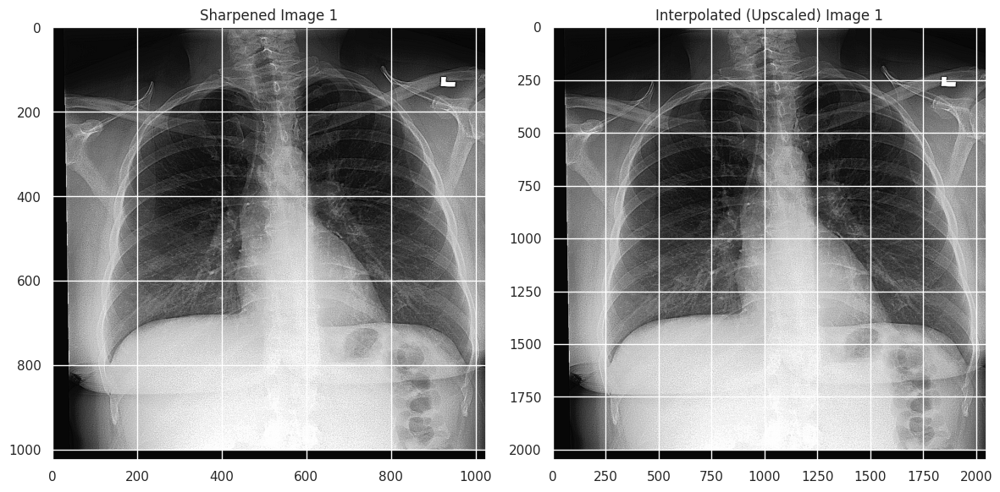

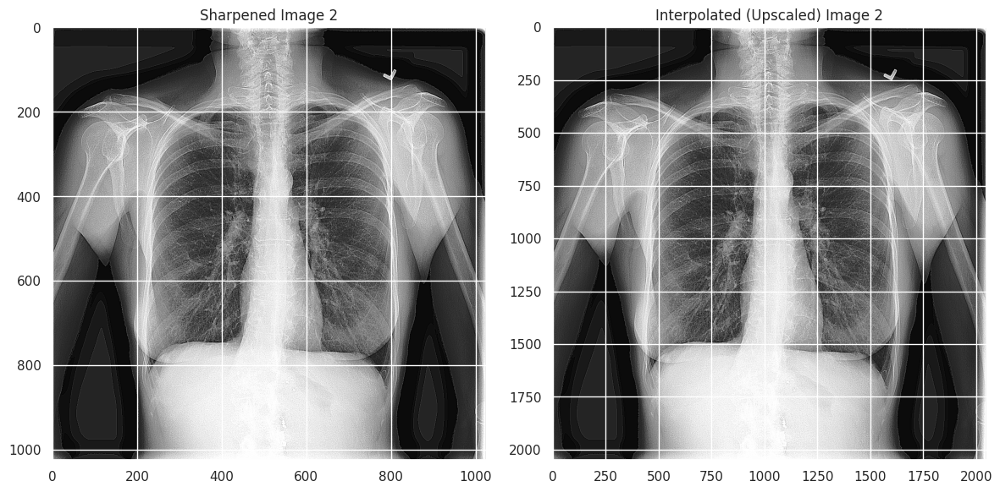

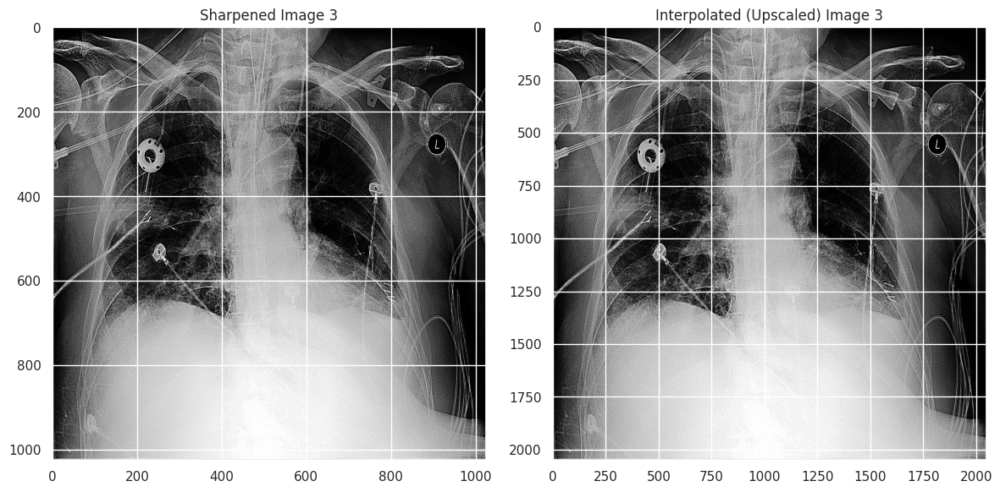

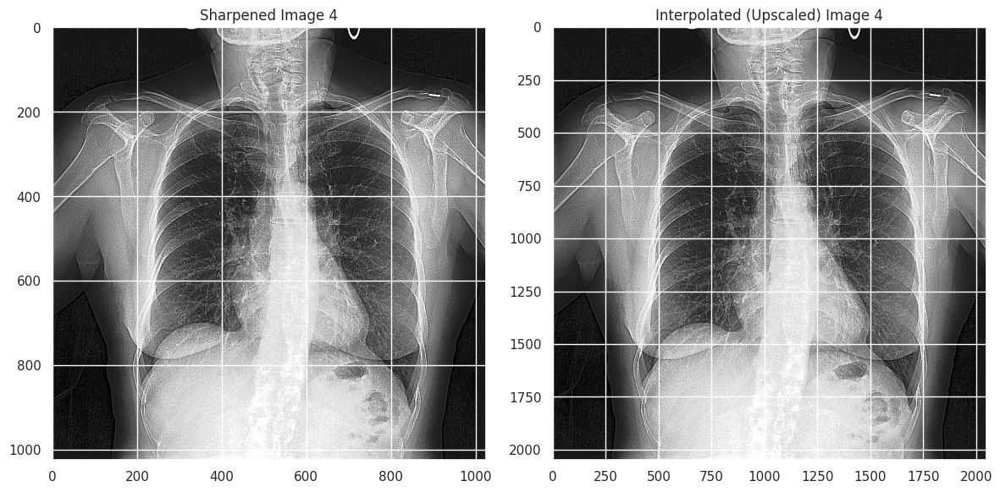

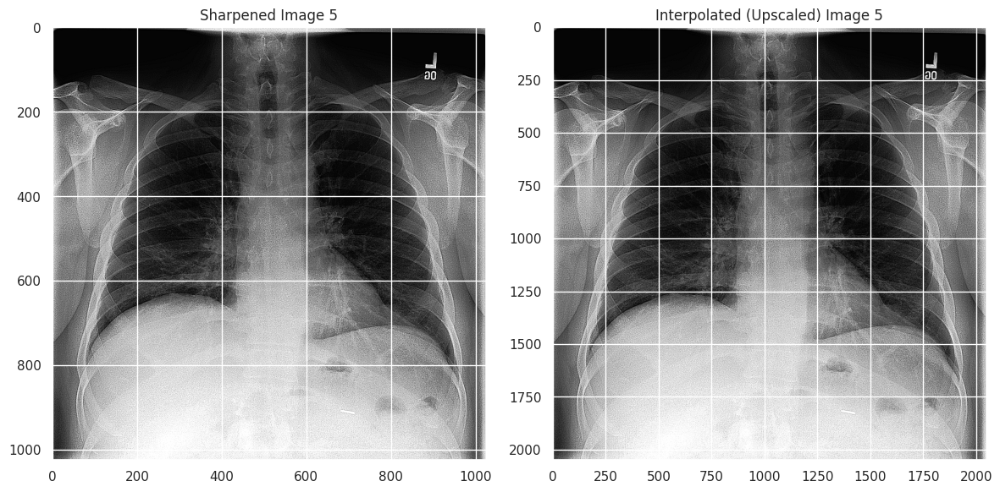

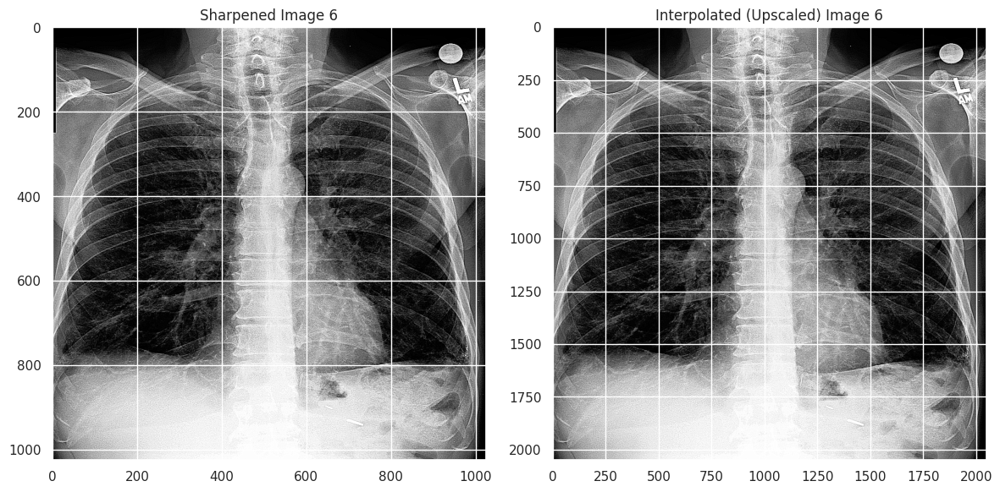

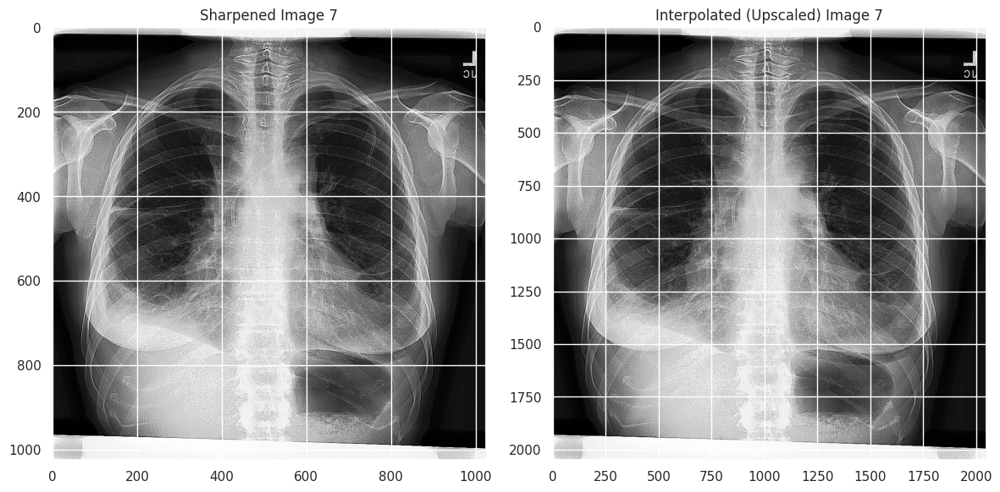

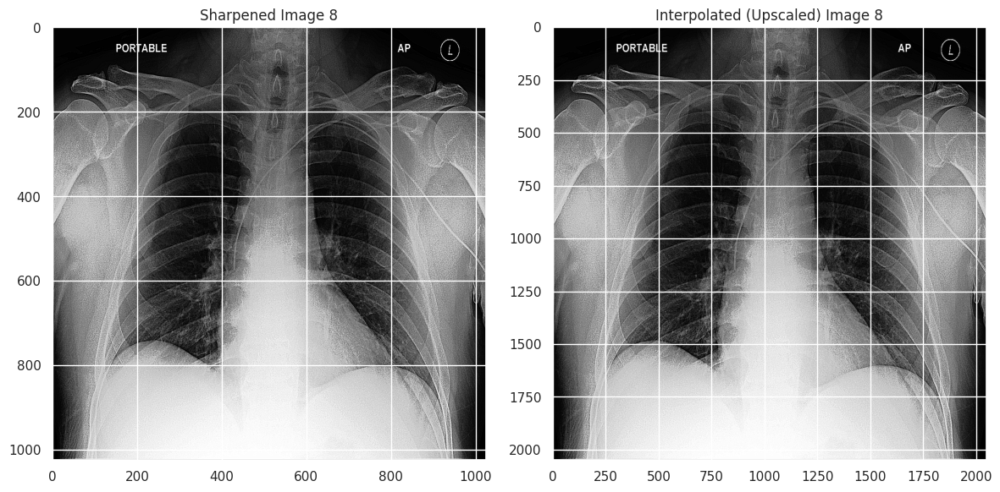

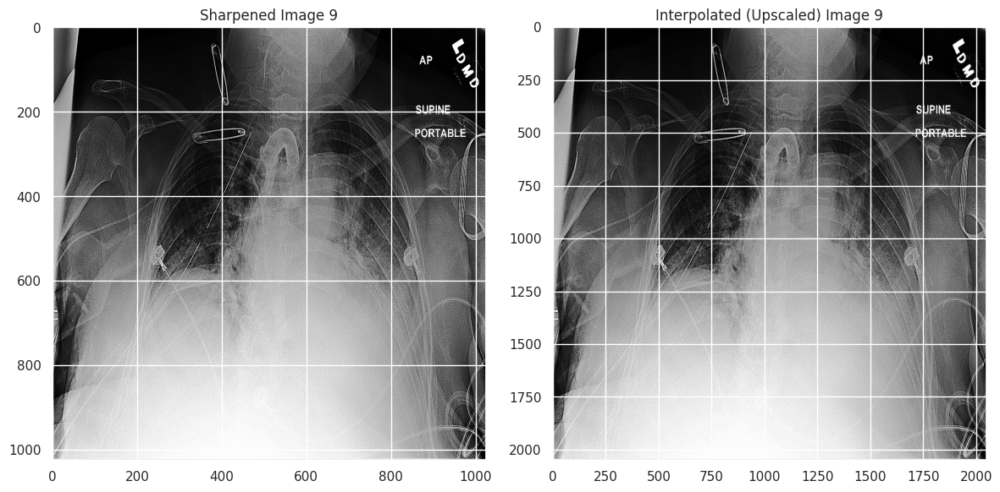

In [ ]:
import numpy as np
import cv2
import os
import matplotlib.pyplot as plt
from scipy.ndimage import zoom
from skimage import exposure

def process_images_and_sharpen(random_images, img_dir, gamma=1.2):
    for i, image_name in enumerate(random_images, start=1):
        # Görüntüyü yükle
        image_path = os.path.join(img_dir, image_name)
        raw_image = plt.imread(image_path)

        # Kontrast genişletme ve gamma düzeltmesi
        min_val, max_val = raw_image.min(), raw_image.max()
        contrast_stretched = (raw_image - min_val) / (max_val - min_val) * 255
        contrast_stretched = contrast_stretched.astype(np.uint8)

        equalized_image = exposure.equalize_hist(contrast_stretched) * 255
        equalized_image = equalized_image.astype(np.uint8)

        gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
        gamma_corrected = gamma_corrected.astype(np.uint8)

        # Step 4: Apply sharpening using an unsharp masking kernel
        sharpening_kernel = np.array([[-1, -1, -1],
                                      [-1,  9, -1],
                                      [-1, -1, -1]])
        sharpened_image = np.clip(cv2.filter2D(gamma_corrected, -1, sharpening_kernel), 0, 255).astype(np.uint8)

        # Step 5: Apply bicubic interpolation to upscale the image by a factor of 2
        scale_factor = 2
        resized_image = zoom(sharpened_image, scale_factor, order=3)  # Bicubic interpolation with `order=3`

        # Visualize results
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1), plt.imshow(sharpened_image, cmap='gray'), plt.title(f"Sharpened Image {i}")
        plt.subplot(1, 2, 2), plt.imshow(resized_image, cmap='gray'), plt.title(f"Interpolated (Upscaled) Image {i}")

        plt.tight_layout()
        plt.show()

# Fonksiyonu çağır ve her görüntü için keskinleştirme ve enterpolasyon işlemlerini görselleştir
process_images_and_sharpen(random_images, img_dir)


Resimlerin her biri keskinleştirilerek könemli noktaların Akciğerlerin çevresindeki sınırlar, kaburga kemikleri ve omurga daha net bir şekilde görülebilir. Görüntüdeki ince detaylar ortaya çıkarılmaya çalışılmıştır. Bütün resimlerde kamburga kısmındaki orjinal resimden daha net bir şekilde seçilmektedir.